# Import Libraries

In [1]:
#Import libraries
#loading dataset
import pandas as pd
import numpy as np

#visualisation
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly
import plotly.offline as pyo
from plotly.offline import iplot
import plotly.express as px
from plotly.subplots import make_subplots

# data splitting
from sklearn.model_selection import train_test_split

# data modeling
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

# Model performance
from sklearn.model_selection import RandomizedSearchCV,GridSearchCV
from sklearn.model_selection import  KFold, cross_val_score, StratifiedKFold
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, classification_report, roc_curve , accuracy_score,plot_confusion_matrix
from sklearn import metrics
from sklearn.preprocessing import label_binarize
from sklearn.preprocessing import StandardScaler, MinMaxScaler

#warnings
import warnings
warnings.simplefilter(action='ignore')

plt.style.use ('seaborn')
from sklearn.pipeline import Pipeline


In [2]:
# Permanently changes the pandas settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)

# Import dataset

In [3]:
#loading data 
data= pd.read_csv('train.csv')
data1=pd.read_csv('test.csv')
df=pd.DataFrame(data)
df

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1
5,1859,0,0.5,1,3,0,22,0.7,164,1,7,1004,1654,1067,17,1,10,1,0,0,1
6,1821,0,1.7,0,4,1,10,0.8,139,8,10,381,1018,3220,13,8,18,1,0,1,3
7,1954,0,0.5,1,0,0,24,0.8,187,4,0,512,1149,700,16,3,5,1,1,1,0
8,1445,1,0.5,0,0,0,53,0.7,174,7,14,386,836,1099,17,1,20,1,0,0,0
9,509,1,0.6,1,2,1,9,0.1,93,5,15,1137,1224,513,19,10,12,1,0,0,0


In [4]:
df1=pd.DataFrame(data1)
df1

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,3,16,226,1412,3476,12,7,2,0,1,0
1,2,841,1,0.5,1,4,1,61,0.8,191,5,12,746,857,3895,6,0,7,1,0,0
2,3,1807,1,2.8,0,1,0,27,0.9,186,3,4,1270,1366,2396,17,10,10,0,1,1
3,4,1546,0,0.5,1,18,1,25,0.5,96,8,20,295,1752,3893,10,0,7,1,1,0
4,5,1434,0,1.4,0,11,1,49,0.5,108,6,18,749,810,1773,15,8,7,1,0,1
5,6,1464,1,2.9,1,5,1,50,0.8,198,8,9,569,939,3506,10,7,3,1,1,1
6,7,1718,0,2.4,0,1,0,47,1.0,156,2,3,1283,1374,3873,14,2,10,0,0,0
7,8,833,0,2.4,1,0,0,62,0.8,111,1,2,1312,1880,1495,7,2,18,0,1,1
8,9,1111,1,2.9,1,9,1,25,0.6,101,5,19,556,876,3485,11,9,10,1,1,0
9,10,1520,0,0.5,0,1,0,25,0.5,171,3,20,52,1009,651,6,0,5,1,0,1


In [5]:
# lists name of columns
data.columns

Index(['battery_power', 'blue', 'clock_speed', 'dual_sim', 'fc', 'four_g',
       'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'three_g',
       'touch_screen', 'wifi', 'price_range'],
      dtype='object')


- battery_power:Total energy a battery can store in one time measured in mAh
- blue:Has bluetooth or not
- clock_speed:speed at which microprocessor executes instructions
- dual_sim:Has dual sim support or not
- fc:Front Camera mega pixels
- four_g:Has 4G or not
- int_memory:Internal Memory in Gigabytes
- m_dep:Mobile Depth in cm
- mobile_wt:Weight of mobile phone
- n_cores:Number of cores of processor
- pc:Primary Camera mega pixels
- px_height:Pixel Resolution Height
- px_width:Pixel Resolution Width
- ram:Random Access Memory in Megabytes
- sc_h:Screen Height of mobile in cm
- sc_w:Screen Width of mobile in cm
- talk_time:longest time that a single battery charge will last when you are
- three_g:Has 3G or not
- touch_screen:Has touch screen or not
- wifi:Has wifi or not
- price_range: This is the target variable with value of 0 (low cost), 1(medium cost), 2(high cost) and 3 (very high cost)

In [6]:
df=pd.DataFrame(data)
df

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1
5,1859,0,0.5,1,3,0,22,0.7,164,1,7,1004,1654,1067,17,1,10,1,0,0,1
6,1821,0,1.7,0,4,1,10,0.8,139,8,10,381,1018,3220,13,8,18,1,0,1,3
7,1954,0,0.5,1,0,0,24,0.8,187,4,0,512,1149,700,16,3,5,1,1,1,0
8,1445,1,0.5,0,0,0,53,0.7,174,7,14,386,836,1099,17,1,20,1,0,0,0
9,509,1,0.6,1,2,1,9,0.1,93,5,15,1137,1224,513,19,10,12,1,0,0,0


# Preprocessing

In [7]:
#to view some basic statistical details of train data
df.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,9.916500,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,6.064315,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,0.000000,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,5.000000,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,10.000000,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,15.000000,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,20.000000,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


- data.describe function returns summary of dataset. Here

- count column means number of values of each column are given,
- mean column means numeric column's mean or average value
- std means a measure of how dispersed the data is in relation to the mean or how far each value from mean value
- min and max columns mean minimun amd maximum values
- 25% 50% 75% colums are if we have 100 sorted values then 25th 50th and 75th data. If mean value and 50% value are not -same or there have huge difference that data must be skewed

In [8]:
# checking the simple statistical parameters of test data

df1.describe()

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000
mean,500.500000,1248.510000,0.516000,1.540900,0.517000,4.593000,0.487000,33.652000,0.517500,139.51100,4.328000,10.054000,627.121000,1239.774000,2138.998000,11.995000,5.316000,11.085000,0.756000,0.50000,0.507000
std,288.819436,432.458227,0.499994,0.829268,0.499961,4.463325,0.500081,18.128694,0.280861,34.85155,2.288155,6.095099,432.929699,439.670981,1088.092278,4.320607,4.240062,5.497636,0.429708,0.50025,0.500201
min,1.000000,500.000000,0.000000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.00000,1.000000,0.000000,0.000000,501.000000,263.000000,5.000000,0.000000,2.000000,0.000000,0.00000,0.000000
25%,250.750000,895.000000,0.000000,0.700000,0.000000,1.000000,0.000000,18.000000,0.300000,109.75000,2.000000,5.000000,263.750000,831.750000,1237.250000,8.000000,2.000000,6.750000,1.000000,0.00000,0.000000
50%,500.500000,1246.500000,1.000000,1.500000,1.000000,3.000000,0.000000,34.500000,0.500000,139.00000,4.000000,10.000000,564.500000,1250.000000,2153.500000,12.000000,5.000000,11.000000,1.000000,0.50000,1.000000
75%,750.250000,1629.250000,1.000000,2.300000,1.000000,7.000000,1.000000,49.000000,0.800000,170.00000,6.000000,16.000000,903.000000,1637.750000,3065.500000,16.000000,8.000000,16.000000,1.000000,1.00000,1.000000
max,1000.000000,1999.000000,1.000000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.00000,8.000000,20.000000,1907.000000,1998.000000,3989.000000,19.000000,18.000000,20.000000,1.000000,1.00000,1.000000


In [9]:
# checking the number of rows and columns in train dataset
rows,col=df.shape
print ('Row:' , rows,'\nColumns:',col)

Row: 2000 
Columns: 21


In [10]:
# checking the number of rows and columns in test dataset
rows,col=df1.shape
print ('Row:' , rows,'\nColumns:',col)

Row: 1000 
Columns: 21


#### This dataset contais 21 columns and 2000 informations or rows

In [11]:
#number of null values in our train dataset
df.isnull().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
price_range      0
dtype: int64

In [12]:
#number of null values in our test dataset
df1.isnull().sum()

id               0
battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
dtype: int64

#### .isnull() function returns is there any null value in any column

- In this dataset there is no Null value

In [13]:
#compare train and test dataset
compare= {'features':['battery_power', 'clock_speed', 'fc', 'int_memory', 'm_dep', 'mobile_wt', 'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time'],
          'train_mean':[df.battery_power.mean(),df.clock_speed.mean(), df.fc.mean()
                       ,df.int_memory.mean(),df.m_dep.mean(),df.mobile_wt.mean(),df.pc.mean(),
                       df.px_height.mean(),df.px_width.mean(),df.ram.mean(),df.sc_h.mean(),
                       df.sc_w.mean(),df.talk_time.mean()],
          'test_mean': [df1.battery_power.mean(),df1.clock_speed.mean(), df1.fc.mean()
                       ,df1.int_memory.mean(),df1.m_dep.mean(),df1.mobile_wt.mean(),df1.pc.mean(),
                       df1.px_height.mean(),df1.px_width.mean(),df1.ram.mean(),df1.sc_h.mean(),
                       df1.sc_w.mean(),df1.talk_time.mean()]}
comparison = pd.DataFrame(compare)
comparison  

,features,train_mean,test_mean
0,battery_power,1238.51850,1248.5100
1,clock_speed,1.52225,1.5409
2,fc,4.30950,4.5930
3,int_memory,32.04650,33.6520
4,m_dep,0.50175,0.5175
5,mobile_wt,140.24900,139.5110
6,pc,9.91650,10.0540
7,px_height,645.10800,627.1210
8,px_width,1251.51550,1239.7740
9,ram,2124.21300,2138.9980


- the mean of the train and the test dataset are close to each other.

In [14]:
#getting some information about the datafram
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

#### .info function returns every columns datatype and size of the dataset

- IN this dataset execpt clock_speed and m_dep , every column type is integer

In [15]:
#To check number of uniqe elements in each columns.
df.nunique()

battery_power    1094
blue             2   
clock_speed      26  
dual_sim         2   
fc               20  
four_g           2   
int_memory       63  
m_dep            10  
mobile_wt        121 
n_cores          8   
pc               21  
px_height        1137
px_width         1109
ram              1562
sc_h             15  
sc_w             19  
talk_time        19  
three_g          2   
touch_screen     2   
wifi             2   
price_range      4   
dtype: int64

- We will divide the variables into categorical and continuous, analyze them and draw conclusions

In [16]:
df.min()

battery_power    501.0
blue             0.0  
clock_speed      0.5  
dual_sim         0.0  
fc               0.0  
four_g           0.0  
int_memory       2.0  
m_dep            0.1  
mobile_wt        80.0 
n_cores          1.0  
pc               0.0  
px_height        0.0  
px_width         500.0
ram              256.0
sc_h             5.0  
sc_w             0.0  
talk_time        2.0  
three_g          0.0  
touch_screen     0.0  
wifi             0.0  
price_range      0.0  
dtype: float64

- there are values equal to zero in both "px_height" and "sc_w". The problem with these points is that they cannot represent a feature of a mobile phone, as there is no 1D pixel or a 1D screen ! 

In [17]:
px_mask = df['px_height'] == 0
sc_mask = df['sc_w'] == 0
print(f'pixel height = 0  :  {sum(px_mask)}')
print(f'screen width = 0  :  {sum(sc_mask)}')

pixel height = 0  :  2
screen width = 0  :  180


In [18]:

df=df[df['sc_w']>=2]
df=df[df['px_height']>0]
df.reset_index(inplace=True)
df.drop('index', axis=1, inplace=True)
df


,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1
5,1821,0,1.7,0,4,1,10,0.8,139,8,10,381,1018,3220,13,8,18,1,0,1,3
6,1954,0,0.5,1,0,0,24,0.8,187,4,0,512,1149,700,16,3,5,1,1,1,0
7,509,1,0.6,1,2,1,9,0.1,93,5,15,1137,1224,513,19,10,12,1,0,0,0
8,769,1,2.9,1,0,0,9,0.1,182,5,1,248,874,3946,5,2,7,0,0,0,3
9,1520,1,2.2,0,5,1,33,0.5,177,8,18,151,1005,3826,14,9,13,1,1,1,3


In [19]:
#Correlation between all features
df.corr()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
battery_power,1.000000,0.037992,0.005418,-0.047783,0.022551,0.027102,0.004404,0.032451,0.014787,-0.029796,0.030813,0.005062,-0.000964,0.001063,-0.038397,-0.011044,0.056313,0.011032,0.004074,0.001426,0.196288
blue,0.037992,1.000000,0.019929,0.026651,-0.009882,0.007626,0.031269,0.013747,-0.034541,0.039419,-0.036116,-0.004938,-0.039250,0.021593,-0.020656,-0.032822,0.019897,-0.021975,-0.000717,-0.029449,0.022046
clock_speed,0.005418,0.019929,1.000000,-0.020580,-0.005582,-0.037279,0.018352,0.006269,-0.002346,-0.021661,-0.005255,-0.006889,-0.006037,-0.004060,-0.019668,0.015714,-0.012090,-0.037983,0.023417,-0.026162,-0.016139
dual_sim,-0.047783,0.026651,-0.020580,1.000000,-0.026336,0.001328,-0.023431,-0.015927,-0.007309,-0.018985,-0.016568,-0.030203,0.008284,0.050488,-0.003551,-0.004534,-0.013021,-0.006602,-0.016893,0.011553,0.022609
fc,0.022551,-0.009882,-0.005582,-0.026336,1.000000,-0.023061,-0.033497,-0.009455,0.028184,-0.025177,0.645338,-0.000137,-0.007737,0.008250,-0.003831,-0.012100,-0.012072,-0.009998,-0.008125,0.002553,0.012357
four_g,0.027102,0.007626,-0.037279,0.001328,-0.023061,1.000000,0.009992,0.000331,-0.006159,-0.001364,0.001746,-0.012064,0.008430,0.005811,0.028877,0.025918,-0.045836,0.585117,0.008655,-0.023417,0.015621
int_memory,0.004404,0.031269,0.018352,-0.023431,-0.033497,0.009992,1.000000,0.002357,-0.029394,-0.034957,-0.047480,0.007047,-0.011173,0.047140,0.026625,-0.005593,-0.024115,0.002111,-0.037262,0.028018,0.058975
m_dep,0.032451,0.013747,0.006269,-0.015927,-0.009455,0.000331,0.002357,1.000000,0.041124,-0.005939,0.035703,0.030582,0.026096,-0.013014,-0.025831,-0.017064,0.032721,-0.009212,0.012881,-0.015535,-0.000956
mobile_wt,0.014787,-0.034541,-0.002346,-0.007309,0.028184,-0.006159,-0.029394,0.041124,1.000000,-0.015273,0.029515,0.009776,0.011347,-0.001901,-0.032329,-0.025287,0.012159,-0.002070,-0.014091,-0.009858,-0.022835
n_cores,-0.029796,0.039419,-0.021661,-0.018985,-0.025177,-0.001364,-0.034957,-0.005939,-0.015273,1.000000,-0.007397,-0.006948,0.017039,-0.019554,0.003925,0.028792,-0.004247,0.001390,0.029871,-0.027634,-0.008647


In [20]:
# better to inspect the correlation of price_range vs. features specifically
price_range_corr = df.corr().sort_values(by = ["price_range"],
                                                 ascending = False).iloc[0].sort_values(ascending = False)
price_range_corr

price_range      1.000000
ram              0.917330
battery_power    0.196288
px_width         0.155291
px_height        0.145118
int_memory       0.058975
sc_w             0.058899
sc_h             0.027184
dual_sim         0.022609
blue             0.022046
three_g          0.019767
talk_time        0.015909
four_g           0.015621
fc               0.012357
pc               0.004713
wifi             0.004313
m_dep           -0.000956
n_cores         -0.008647
clock_speed     -0.016139
touch_screen    -0.020838
mobile_wt       -0.022835
Name: price_range, dtype: float64

# Exploratory Data Analysis (EDA)

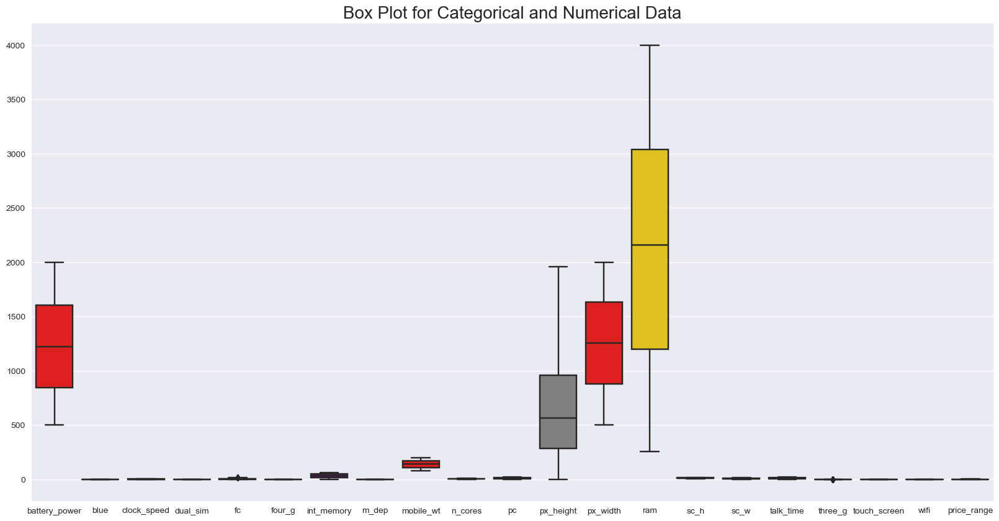

In [21]:
# Define custom colors
custom_colors = ['red', 'gold', 'purple', 'gray']
# Set the figure size
plt.figure(figsize=(20, 10))
# Create a box plot with Seaborn using custom colors
sns.boxplot(data=df, palette=custom_colors)
# Set a more informative title
plt.title('Box Plot for Categorical and Numerical Data', fontsize=20)
# Show the plot
plt.show()

In [22]:
# vidualtion categorical and numerical columns.
categorical_variables=[col for col in df.columns if df[col].nunique()<=8]
print('categorical:',categorical_variables)
continuous_variables=[col for col in df.columns if df[col].nunique()>8]
print('continuous:' ,continuous_variables)

categorical: ['blue', 'dual_sim', 'four_g', 'n_cores', 'three_g', 'touch_screen', 'wifi', 'price_range']
continuous: ['battery_power', 'clock_speed', 'fc', 'int_memory', 'm_dep', 'mobile_wt', 'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time']


- there are 8 categorical columns and 13 continuous columns

### Checking Categorical Data

In [23]:
# check for cardinality in categorical variables
cate_cols=['blue', 'dual_sim','four_g','n_cores', 'three_g', 'touch_screen', 'wifi', 'price_range']
for var in cate_cols:
    
    print(var,':', ' contains ', len(df[var].unique()), ' labels')

blue :  contains  2  labels
dual_sim :  contains  2  labels
four_g :  contains  2  labels
n_cores :  contains  8  labels
three_g :  contains  2  labels
touch_screen :  contains  2  labels
wifi :  contains  2  labels
price_range :  contains  4  labels


### Bluetooth

In [24]:
# Define custom colors
custom_colors = ['red', 'gold', 'purple', 'gray']
# Create a histogram plot with custom colors
fig = px.histogram(df, x='blue', color='price_range', 
                   title='Comparison of devices sold having Bluetooth or not',
                   color_discrete_sequence=custom_colors)
# Update the layout
fig.update_layout(bargap=0.2)  # Adjust 'bargap' to your preference

# Show the plot
fig.show()

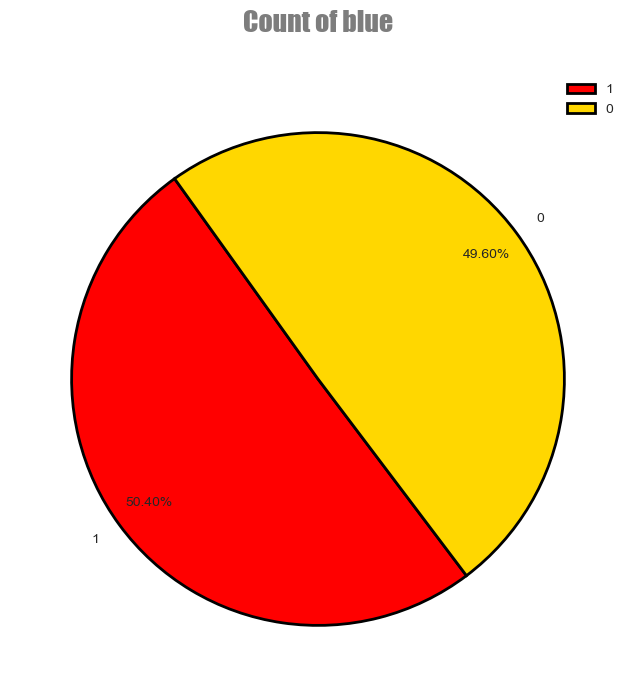

In [25]:
# Calculate the counts and labels
counts = df['blue'].value_counts()
sizes = counts.values
labels = counts.index
# Define custom colors (cyan and gold)
colors = ['red', '#FFD700']
# Create a 2D pie chart with a border
plt.figure(figsize=(10, 8))
plt.title('Count of blue', fontname='Impact', fontsize=20, y=1.05, alpha=0.6)
plt.pie(sizes, labels=labels, startangle=125.6, autopct='%1.2f%%', colors=colors, pctdistance=0.85, wedgeprops={'linewidth': 2, 'edgecolor': 'black'})
plt.legend(loc='upper right')
plt.show()

### Dual Sim

In [26]:
# Define custom colors
custom_colors = ['red', 'gold', 'purple', 'gray']
# Create a histogram plot with custom colors
fig = px.histogram(df, x='dual_sim', color='price_range', 
                   title='Comparison of devices sold having Dual Sim or not',
                   color_discrete_sequence=custom_colors)
# Update the layout
fig.update_layout(bargap=0.2)  # Adjust 'bargap' to your preference

# Show the plot
fig.show()

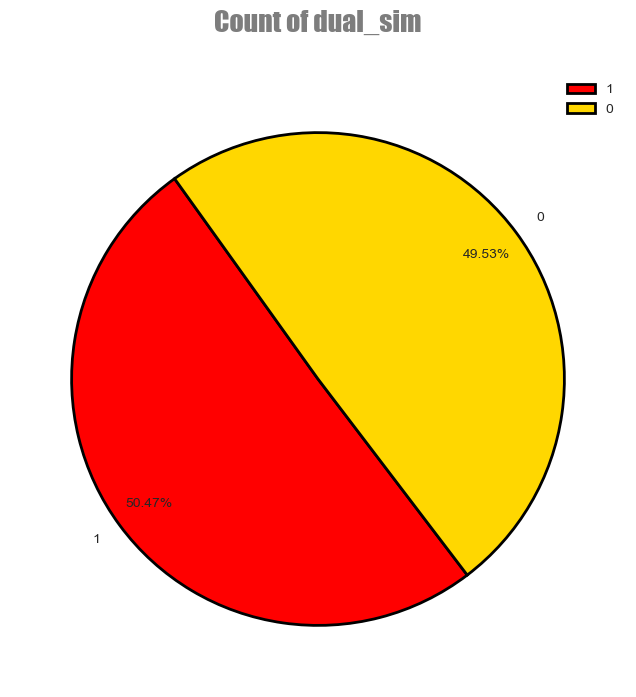

In [27]:
# Calculate the counts and labels
counts = df['dual_sim'].value_counts()
sizes = counts.values
labels = counts.index
# Define custom colors (cyan and gold)
colors = ['red', '#FFD700']
# Create a 2D pie chart with a border
plt.figure(figsize=(10, 8))
plt.title('Count of dual_sim', fontname='Impact', fontsize=20, y=1.05, alpha=0.6)
plt.pie(sizes, labels=labels, startangle=125.6, autopct='%1.2f%%', colors=colors, pctdistance=0.85, wedgeprops={'linewidth': 2, 'edgecolor': 'black'})
plt.legend(loc='upper right')
plt.show()

- The number of mobiles phones whit two Simcards is almost equal to the number of mobile phones without.

### four_g

In [28]:
# Define custom colors
custom_colors = ['red', 'gold', 'purple', 'gray']
# Create a histogram plot with custom colors
fig = px.histogram(df, x='four_g', color='price_range', 
                   title='Comparison of devices sold having 4G or not',
                   color_discrete_sequence=custom_colors)
# Update the layout
fig.update_layout(bargap=0.2)  # Adjust 'bargap' to your preference
# Show the plot
fig.show()

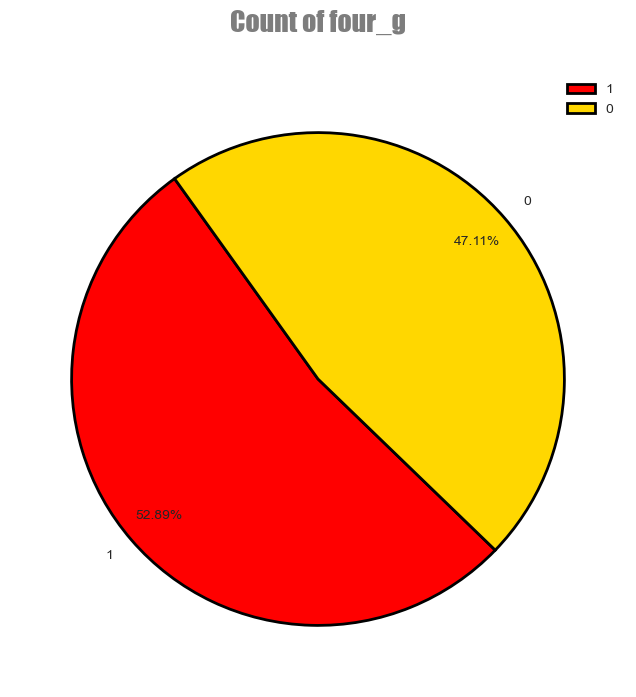

In [29]:
# Calculate the counts and labels
counts = df['four_g'].value_counts()
sizes = counts.values
labels = counts.index
# Define custom colors (cyan and gold)
colors = ['red', '#FFD700']
# Create a 2D pie chart with a border
plt.figure(figsize=(10, 8))
plt.title('Count of four_g', fontname='Impact', fontsize=20, y=1.05, alpha=0.6)
plt.pie(sizes, labels=labels, startangle=125.6, autopct='%1.2f%%', colors=colors, pctdistance=0.85, wedgeprops={'linewidth': 2, 'edgecolor': 'black'})
plt.legend(loc='upper right')
plt.show()

- The number of mobiles phones that are 4-g is almost equal to the others that are not.

### n_cores

In [30]:
# Define custom colors
custom_colors = ['red', '#FFD700', 'purple', 'gray']
# Create a histogram plot with custom colors
fig = px.histogram(df, x='n_cores', color='price_range', 
                   title='Comparison of devices with different Cores',
                   color_discrete_sequence=custom_colors,
                   barmode='group')  # You can use 'barmode' for better alignment
# Update the layout
fig.update_layout(bargap=0.2)  # Adjust 'bargap' to your preference

# Show the plot
fig.show()

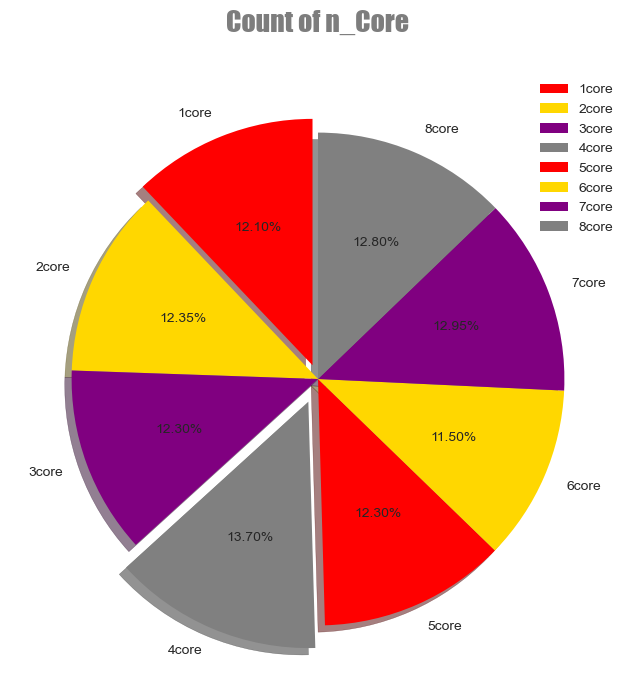

In [31]:
# Define custom colors
custom_colors = ['red', 'gold', 'purple', 'gray']
core_label = ['1core', '2core', '3core', '4core', '5core', '6core', '7core', '8core']
core_size = [242, 247, 246, 274, 246, 230, 259, 256]
core_explode = (0.06, 0, 0, 0.1, 0, 0, 0, 0)
plt.figure(figsize=(10, 8))
plt.pie(core_size, explode=core_explode, labels=core_label, shadow=True, autopct='%1.2f%%', startangle=90, colors=custom_colors)
plt.title("Count of n_Core", fontname='Impact', fontsize=20, y=1.05, alpha=0.6)
plt.legend()
plt.show()

### three_g

In [32]:
# Define custom colors
custom_colors = ['red', 'gold', 'purple', 'gray']
# Create a histogram plot with custom colors
fig = px.histogram(df, x='three_g', color='price_range', 
                   title='Comparison of devices sold having 3G or not',
                   color_discrete_sequence=custom_colors)
# Update the layout
fig.update_layout(bargap=0.2)  # Adjust 'bargap' to your preference
# Show the plot
fig.show()

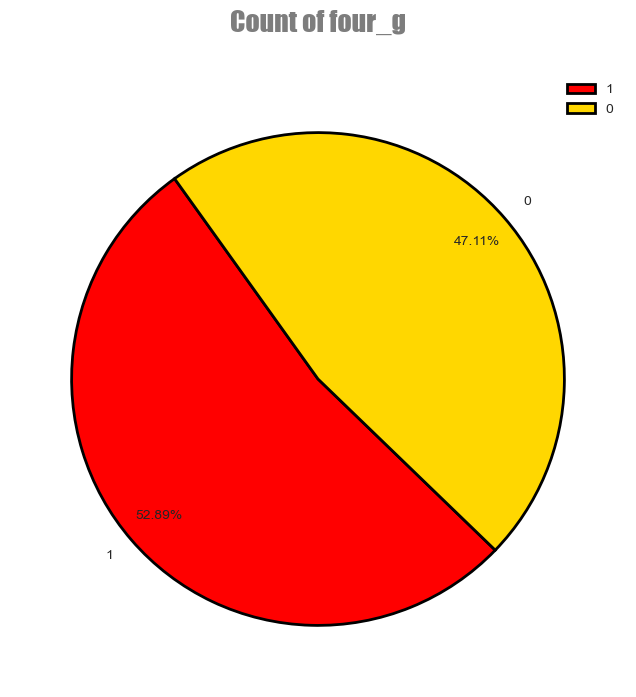

In [33]:
# Calculate the counts and labels
counts = df['four_g'].value_counts()
sizes = counts.values
labels = counts.index
# Define custom colors (red and gold)
colors = ['red', '#FFD700']
# Create a 2D pie chart
plt.figure(figsize=(10, 8))
plt.title('Count of four_g', fontname='Impact', fontsize=20, y=1.05, alpha=0.6)
plt.pie(sizes, labels=labels, startangle=125.6, autopct='%1.2f%%', colors=colors, pctdistance=0.85, wedgeprops={'linewidth': 2, 'edgecolor': 'black'})
plt.legend(labels, loc='upper right')
# Show the pie chart
plt.show()

### touch_screen

In [34]:
# Define custom colors
custom_colors = ['red', 'gold', 'purple', 'gray']
# Create a histogram plot with custom colors
fig = px.histogram(df, x='touch_screen', color='price_range', 
                   title='Comparison of devices sold having touch screen or not',
                   color_discrete_sequence=custom_colors)
# Update the layout
fig.update_layout(bargap=0.2)  # Adjust 'bargap' to your preference
# Show the plot
fig.show()

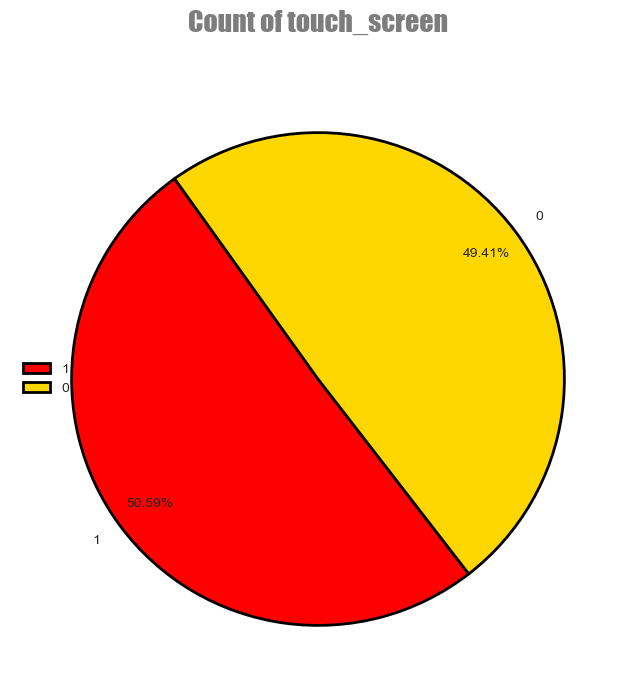

In [35]:
# Calculate the counts and labels
counts = df['touch_screen'].value_counts()
sizes = counts.values
labels = counts.index
# Define custom colors (red, gold, black, and gray)
colors = ['red', 'gold']
# Create a pie chart with custom colors
plt.figure(figsize=(10, 8))
plt.title('Count of touch_screen', fontname='Impact', fontsize=20, y=1.05, alpha=0.6)
plt.pie(sizes, labels=labels, startangle=125.6, autopct='%1.2f%%', colors=colors, pctdistance=0.85, wedgeprops={'linewidth': 2, 'edgecolor': 'black'})
plt.legend(labels, loc='center left')
# Show the pie chart
plt.show()

### wifi

In [36]:
# Define custom colors for the wifi histogram
custom_colors = ['red', 'gold', 'purple', 'gray']
# Create a histogram plot with custom colors for the 'wifi' feature
fig = px.histogram(df, x='wifi', color='price_range', 
                   title='Comparison of devices sold having wifi or not',
                   color_discrete_sequence=custom_colors)
# Update the layout
fig.update_layout(bargap=0.2)  # Adjust 'bargap' to your preference
# Show the plot
fig.show()

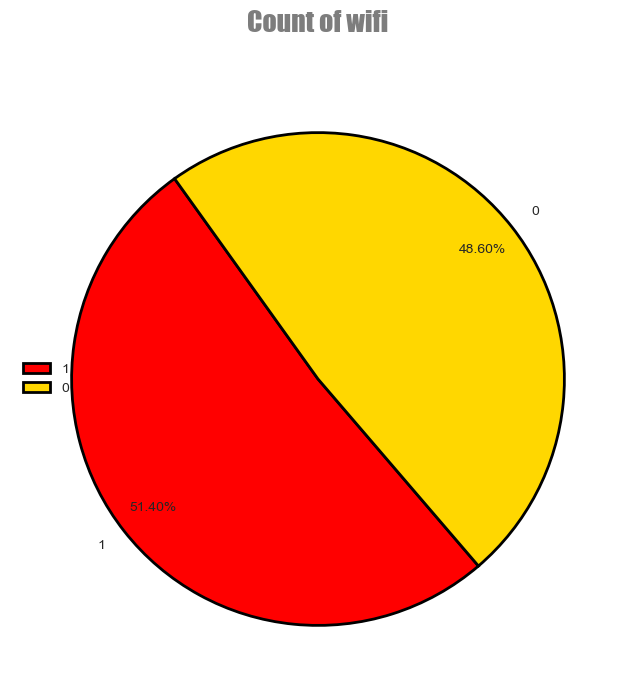

In [37]:
# Calculate the counts and labels
counts = df['wifi'].value_counts()
sizes = counts.values
labels = counts.index
# Define custom colors (red and gold)
colors = ['red', 'gold']
# Create a pie chart with custom colors
plt.figure(figsize=(10, 8))
plt.title('Count of wifi', fontname='Impact', fontsize=20, y=1.05, alpha=0.6)
plt.pie(sizes, labels=labels, startangle=125.6, autopct='%1.2f%%', colors=colors, pctdistance=0.85, wedgeprops={'linewidth': 2, 'edgecolor': 'black'})
plt.legend(labels, loc='center left')
# Show the pie chart
plt.show()

- The number of mobiles phones that have Wifi is almost equal to the number of mobile phones that are not

### price range

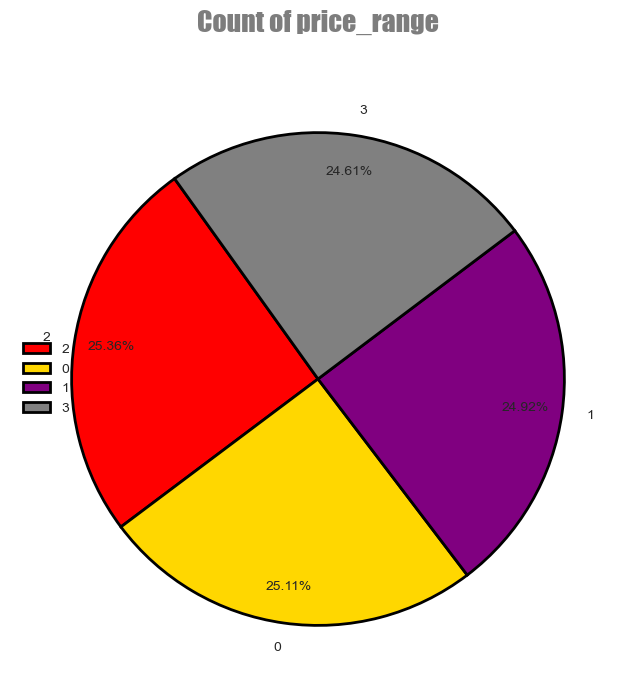

In [38]:
# Calculate the counts and labels
counts = df['price_range'].value_counts()
sizes = counts.values
labels = counts.index
# Define custom colors (red and gold)
colors = ['red', 'gold', 'purple', 'gray']
# Create a pie chart with custom colors and borders
plt.figure(figsize=(10, 8))
plt.title('Count of price_range', fontname='Impact', fontsize=20, y=1.05, alpha=0.6)
plt.pie(sizes, labels=labels, startangle=125.6, autopct='%1.2f%%', colors=colors, pctdistance=0.85, wedgeprops={'linewidth': 2, 'edgecolor': 'black'})
plt.legend(labels, loc='center left')
# Show the pie chart
plt.show()

- We have the same number of phone for every price range, that's a good things to learn and train a dataset

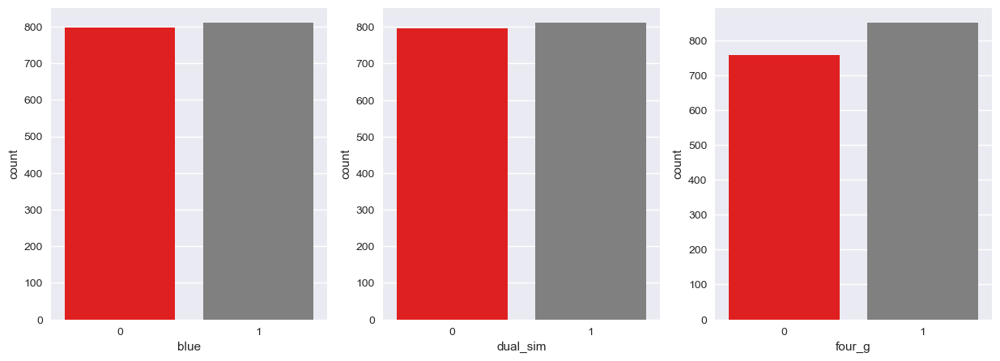

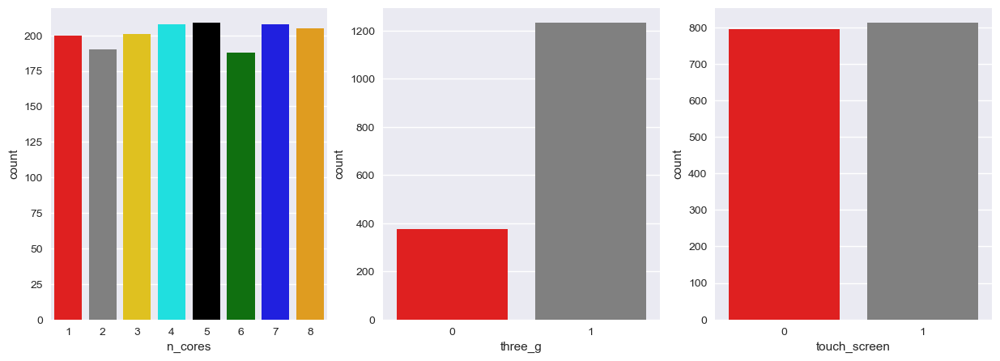

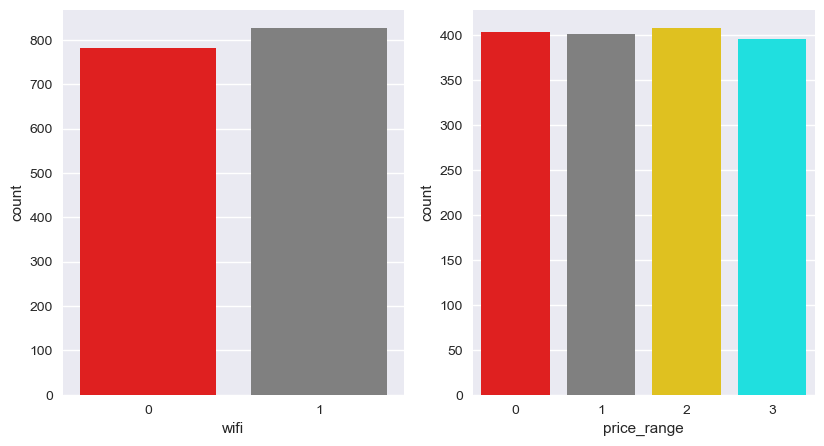

In [39]:
# Define custom colors
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue','orange']
# Categorical columns to plot
cate_cols = ['blue', 'dual_sim', 'four_g', 'n_cores', 'three_g', 'touch_screen', 'wifi', 'price_range']
i = 0
while i < 7:  # Limit to 7 columns to avoid out of bounds error
    fig = plt.figure(figsize=(15, 5))    
    for j in range(1, 4):
        plt.subplot(1, 3, j)
        sns.countplot(x=cate_cols[i], data=df, palette=custom_colors)
        i += 1
        if i >= len(cate_cols):
            break    
    plt.show()

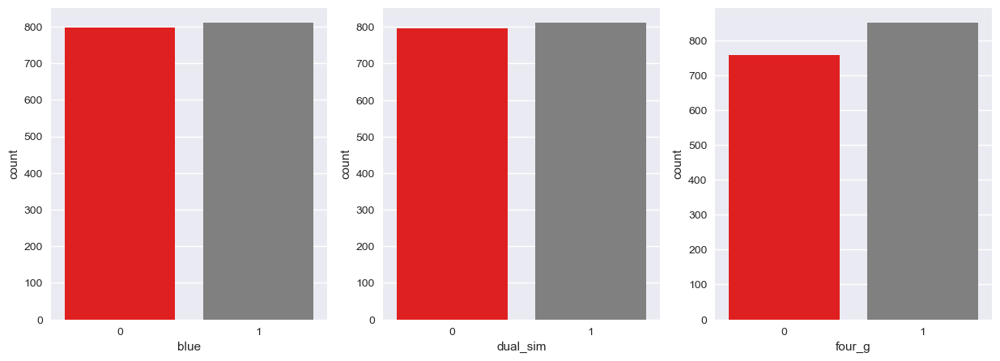

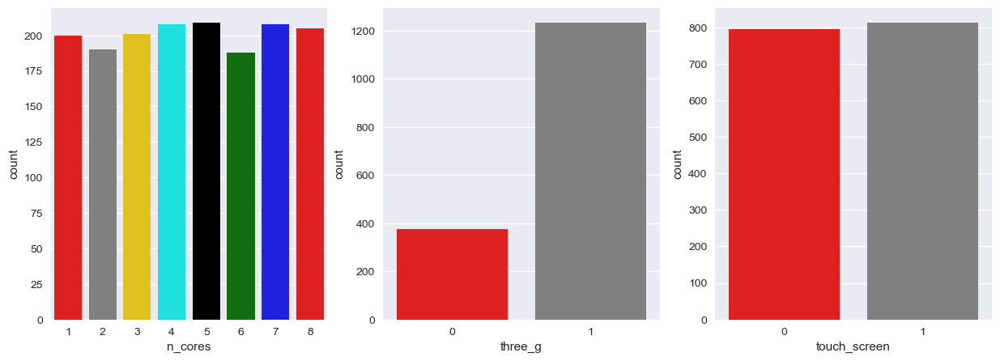

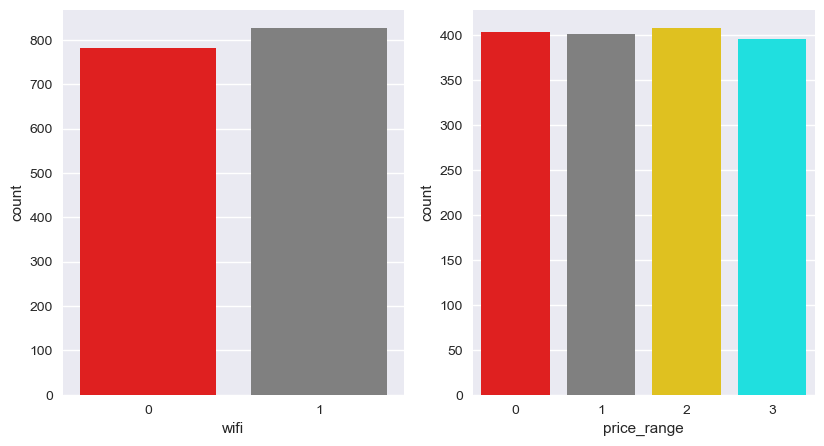

In [40]:
# Define custom colors
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue']
# Categorical columns to plot
cate_cols = ['blue', 'dual_sim', 'four_g', 'n_cores', 'three_g', 'touch_screen', 'wifi', 'price_range']
i = 0
while i < 7:  # Limit to 7 columns to avoid out of bounds error
    fig = plt.figure(figsize=(15, 5))    
    for j in range(1, 4):
        plt.subplot(1, 3, j)
        sns.countplot(x=cate_cols[i], data=df, palette=custom_colors)
        i += 1
        if i >= len(cate_cols):
            break    
    plt.show()

observation
- As it can be seen, except "three_g", distributions in all other features are balanced, as well as the classes of the target.
- Note that, 6 features are of boolean type. These features are "blue", "dual_sim", "four_g", "three_g", "touch_screen", and "wifi". In addition, values of the feature "n_cores" are discrete.

<Figure size 700x900 with 0 Axes>

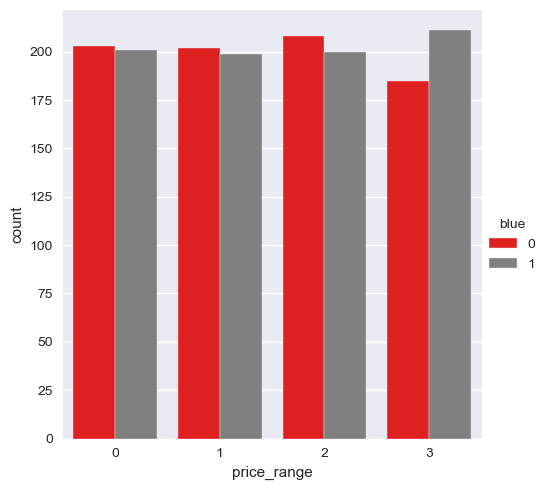

<Figure size 700x900 with 0 Axes>

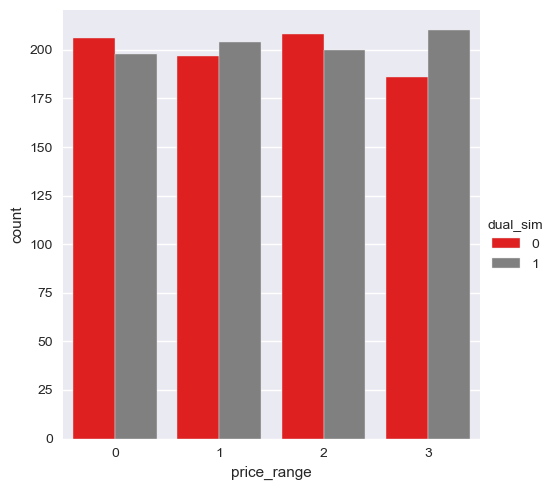

<Figure size 700x900 with 0 Axes>

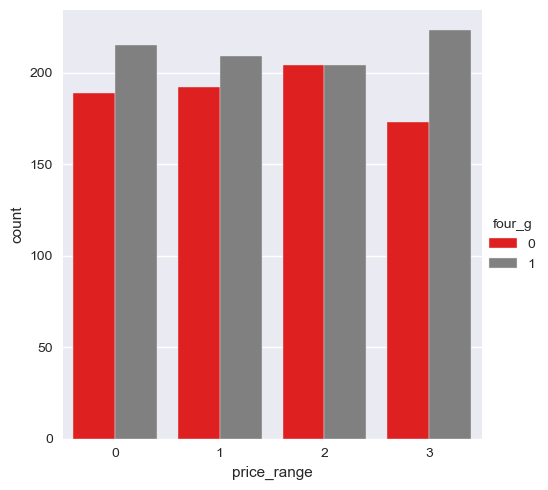

<Figure size 700x900 with 0 Axes>

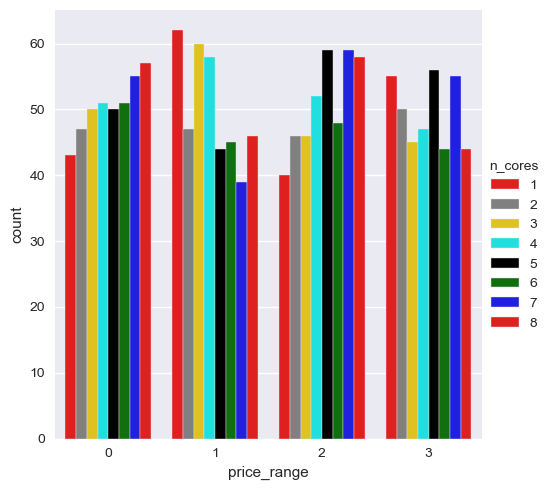

<Figure size 700x900 with 0 Axes>

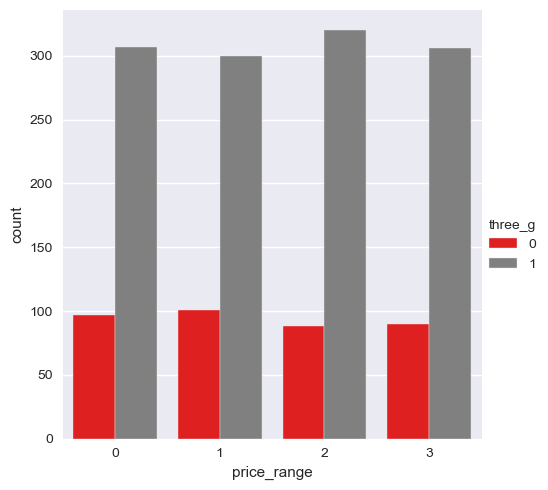

<Figure size 700x900 with 0 Axes>

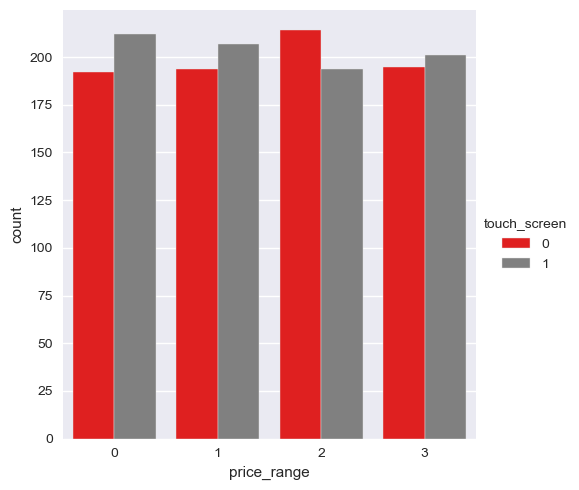

<Figure size 700x900 with 0 Axes>

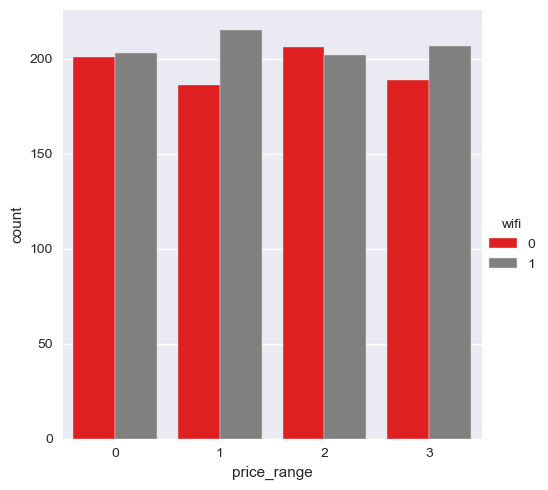

In [41]:
# Define custom colors for 'price_range'
price_range_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue']
# Categorical columns to plot
cate_cols = ['blue', 'dual_sim', 'four_g', 'n_cores', 'three_g', 'touch_screen', 'wifi']
for i in range(7):
    plt.figure(figsize=(7, 9))
    sns.catplot(x="price_range", hue=cate_cols[i], kind="count", palette=price_range_colors, edgecolor=".9", data=df)
    plt.show()

observation:
- expensive mobile has bluetooth
- if mobile has dual_sim card holder than price will be increased
- Very expensive mobile provide 4 g facility
- Very expensive mobile provide 3 g facility

### Checking Numerical Data

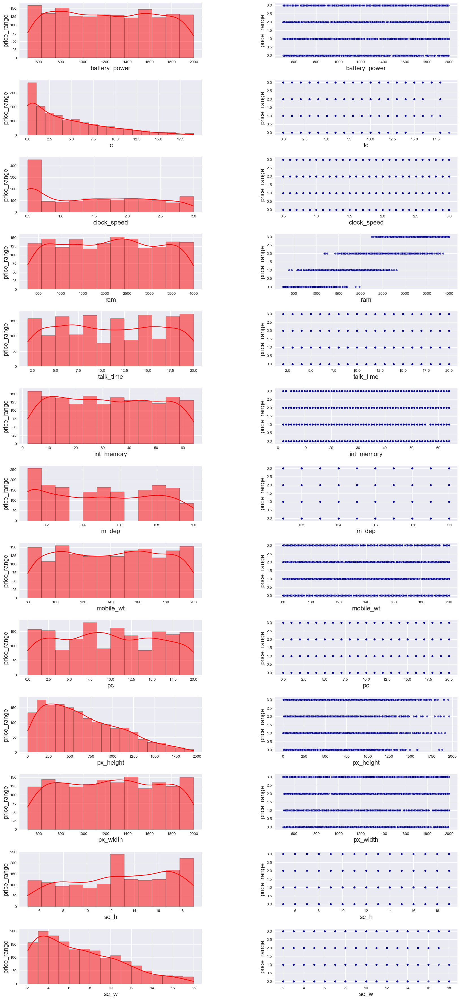

In [42]:
# List of numerical columns
Colsnum = ['battery_power', 'fc', 'clock_speed', 'ram', 'talk_time', 'int_memory', 'm_dep',
           'mobile_wt', 'pc', 'px_height', 'px_width', 'sc_h', 'sc_w']
# Number of rows and columns for subplots
rows = 13
cols = 2
# Create a figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(20, 45))
plt.subplots_adjust(wspace=0.4, hspace=0.4)
# Counter for the Colsnum list
counter = 0
# Colors for plots
hist_color = 'red'  # Red for histograms
scatter_color = 'darkblue'  # Gold for scatter plots
# Loop through rows and columns
for row in range(rows):
    for col in range(cols):
        ax = axes[row, col]        
        # Create histograms for even-indexed columns
        if counter % 2 == 0:
            sns.histplot(df[Colsnum[counter // 2]], kde=True, ax=ax, color=hist_color)
            ax.set_xlabel(Colsnum[counter // 2], fontsize=16)
            ax.set_ylabel('price_range', fontsize=16)        
        # Create scatter plots for odd-indexed columns
        else:
            sns.scatterplot(x=Colsnum[counter // 2], y='price_range', data=df, ax=ax, color=scatter_color, alpha=0.7, s=30)
            ax.set_xlabel(Colsnum[counter // 2], fontsize=16)
            ax.set_ylabel('price_range', fontsize=16)        
        counter += 1
# Adjust the layout
plt.show()


Analysis:
- The dataset appears to be relatively free of noise and outliers, suggesting that the data is clean and well-prepared.
- There is a clear positive correlation between RAM size and the price of mobile devices. This indicates that as RAM size increases, the price range of the mobile device also tends to increase, highlighting a strong relationship between these two variables.
- In the 0 class (representing low-cost mobiles), RAM values typically range from 0 to 2000 megabytes, reflecting the cost-effective nature of these devices.
- In the 1 class (representing medium-cost mobiles), RAM values vary from 0 to 3000 megabytes, indicating a slightly wider range of RAM capacities compared to low-cost devices.
- In the 2 class (representing high-cost mobiles), RAM values typically range from 1000 to 4000 megabytes, showing that these devices offer more substantial RAM options.
- In the 3 class (representing very high-cost mobiles), RAM values span from 2000 to 4000 megabytes, with many devices in this category featuring RAM capacities between 3500 and 4000 megabytes, highlighting the emphasis on high-performance and premium features in this price range.

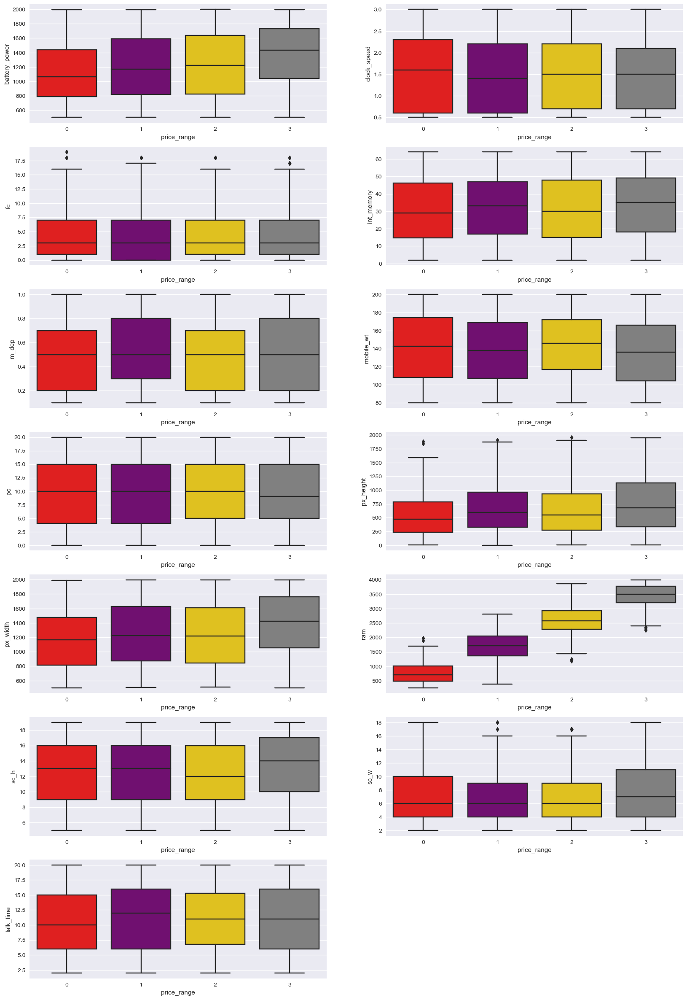

In [43]:
nume_cols=['battery_power', 'clock_speed', 'fc', 'int_memory', 'm_dep', 'mobile_wt',
           'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time']
# Define custom colors
custom_colors = ["red", "purple", "gold", "gray"]
fig = plt.figure(figsize=(20, 30))
for i, col in enumerate(nume_cols):
    ax = fig.add_subplot(7, 2, i + 1)
    sns.boxplot(y=df[col], x=df['price_range'], palette=custom_colors)

Analysis:
- High-end smartphones tend to feature larger memory capacities and more significant battery power. This reflects the market's emphasis on delivering top-tier performance and functionality for premium-priced devices.
- The thickness of a mobile device can impact its price, with thicker models being more budget-friendly, while ultra-thin devices tend to be more expensive. This could be due to the materials and engineering required for slim designs.
- Lower-priced mobile phones are generally lighter in weight. This is because they may lack some of the heavy components, such as larger batteries and advanced camera systems, found in more expensive models.
- The quality and features of the primary camera significantly influence a mobile device's price. High-end devices often boast advanced camera technology, which contributes to their higher cost.
- Interestingly, the data indicates that mobile phones in the low to medium price range offer longer talk times. This suggests that these devices prioritize communication capabilities, providing extended talk time for users.

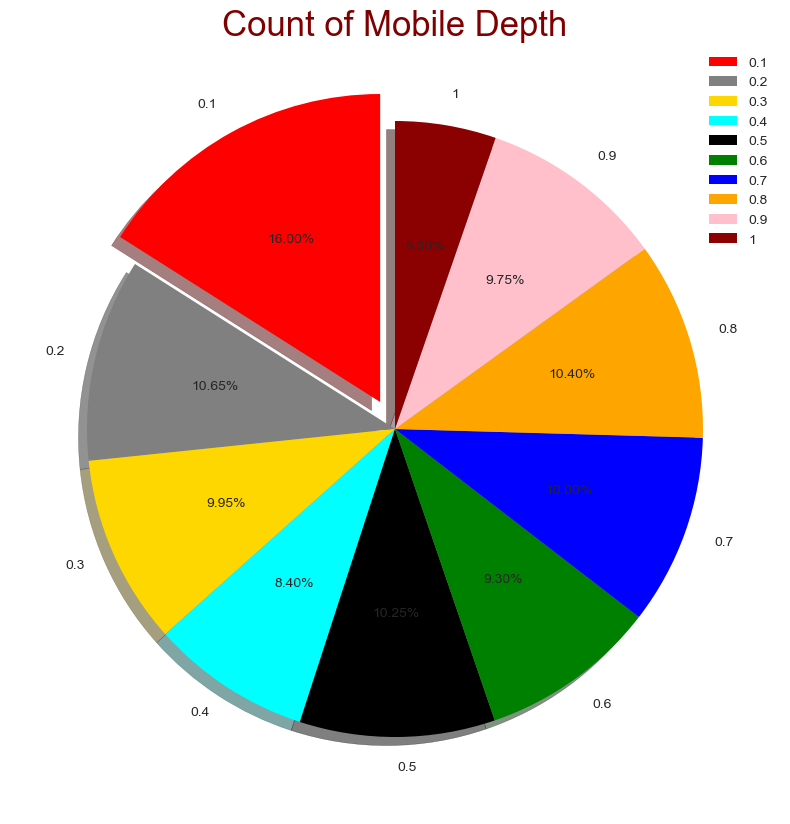

In [44]:
# Data
m_dep_label = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]
m_dep_size = [320, 213, 199, 168, 205, 186, 200, 208, 195, 106]
m_dep_explode = (0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0)
# Custom colors
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue', 'orange', 'pink', 'darkred']
# Create the pie chart
plt.figure(figsize=(13, 10))
plt.pie(m_dep_size, explode=m_dep_explode, labels=m_dep_label, shadow=True, autopct='%1.2f%%', startangle=90, colors=custom_colors)
plt.title("Count of Mobile Depth", fontsize=25, color='maroon')
plt.legend()

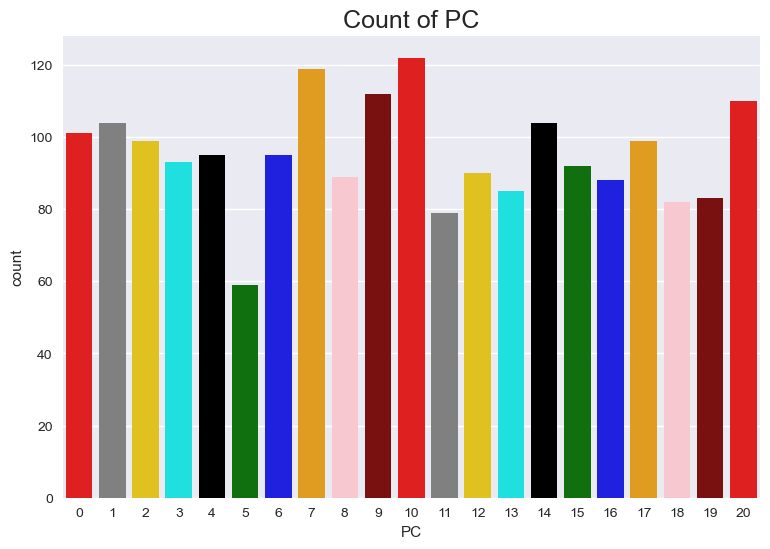

In [45]:
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue', 'orange', 'pink', 'darkred']
plt.figure(figsize=(9, 6))
sns.countplot(data['pc'], data=df, palette=custom_colors)
plt.title("Count of PC", size=18)
plt.xlabel('PC')
plt.show()

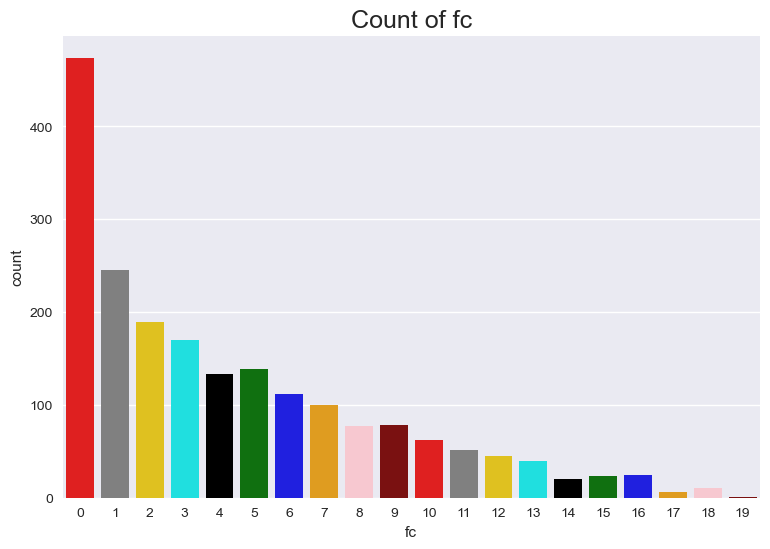

In [46]:
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue', 'orange', 'pink', 'darkred']
plt.figure(figsize=(9, 6))
sns.countplot(data['fc'], data=df, palette=custom_colors)
plt.title("Count of fc", size=18)
plt.xlabel('fc')
plt.show()

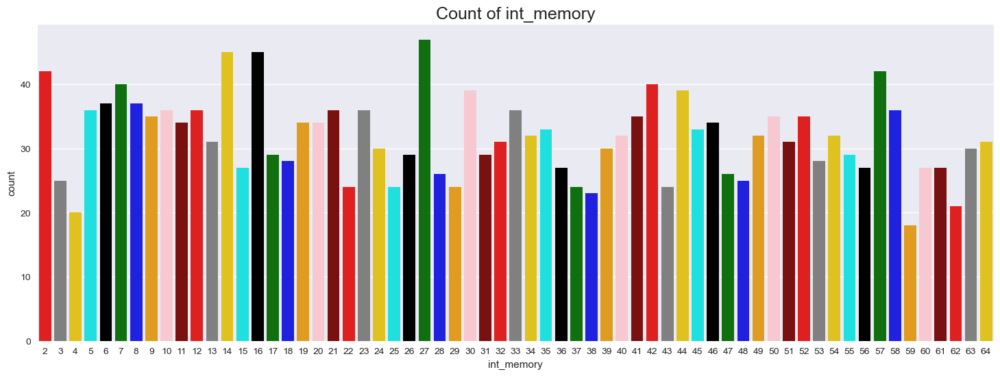

In [47]:
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue', 'orange', 'pink', 'darkred']
plt.figure(figsize=(18, 6))
sns.countplot(data['int_memory'], data=df, palette=custom_colors)
plt.title("Count of int_memory", size=18)
plt.xlabel('int_memory')
plt.show()

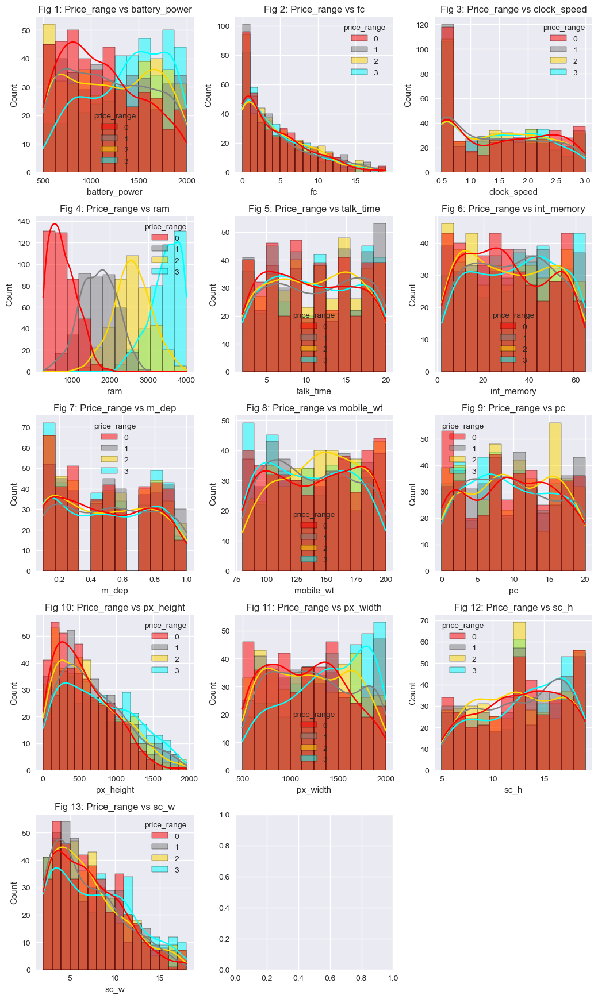

In [48]:
nume_cols = ['battery_power', 'fc', 'clock_speed', 'ram', 'talk_time', 'int_memory', 'm_dep',
             'mobile_wt', 'pc', 'px_height', 'px_width', 'sc_h', 'sc_w']
n_rows = 5
n_cols = 3
fig, ax = plt.subplots(n_rows, n_cols, figsize=(n_cols * 3.5, n_rows * 3.5))
custom_colors = ['red', 'gray', 'gold', 'cyan']
for r in range(0, n_rows):
    for c in range(0, n_cols):
        idx = r * n_cols + c  # index loop through the list
        if idx < len(nume_cols):
            ax_idx = ax[r, c]
            sns.histplot(data=df, x=nume_cols[idx], hue='price_range', kde=True,
                         palette=custom_colors, ax=ax_idx)
            ax_idx.set_title(f"Fig {idx + 1}: Price_range vs {nume_cols[idx]}")
ax.flat[-1].set_visible(False)  # remove subplot that isn't used
plt.tight_layout()
plt.show()

observation
1. Cell phones belonging to the group with a price range of 0 are widely distributed on the side with low battery power.
2. Cell phones belonging to a group with a price range of 3 are widely distributed on the side with high battery power.
3. Battery power is relatively evenly distributed for cell phones belonging to the group with price range 1 and 2.
4. RAM size increases Price of the Mobile 
5. Most of the values of clock speed are distributed between 0.5 and 0.6.
6. The higher the Pixel height, the smaller the number of cell phones.


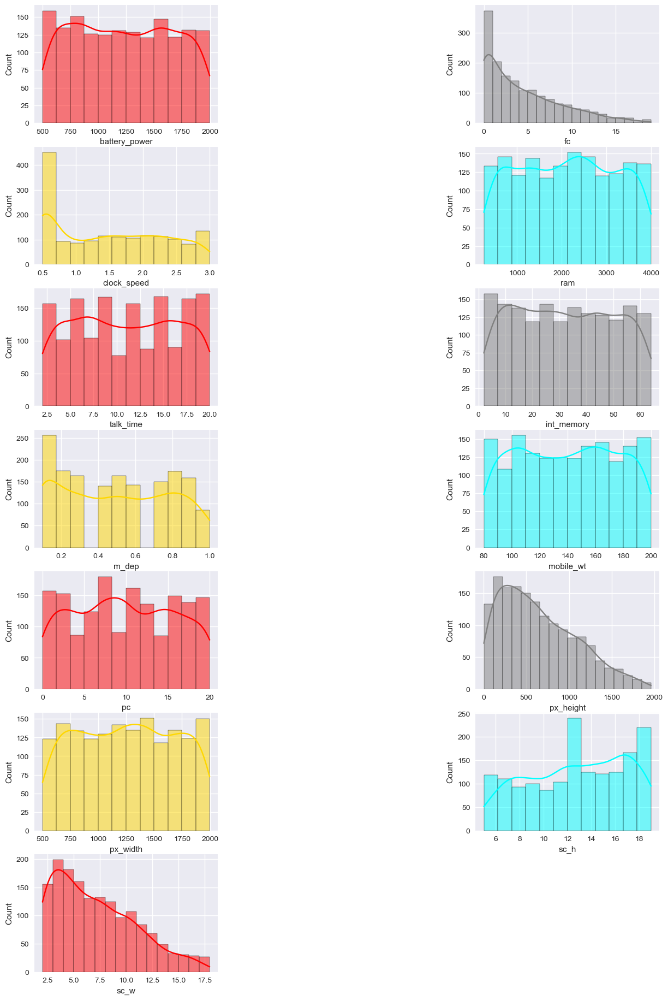

In [49]:
##Checking distributions of numerical data
fig = plt.figure(figsize=(20, 60))
for index, feature in enumerate(nume_cols):
    plt.subplot(18, 4, index * 2 + 1)
    sns.histplot(df[feature], kde=True, color=custom_colors[index % len(custom_colors)])
plt.show()

In [50]:
df_group=df.copy()

In [51]:
battery_gp = []
for i in df_group["battery_power"]:
    if 500 < i <= 1000:
        battery_gp.append("low")
    elif 1000 < i <= 1500:
        battery_gp.append("medium")
    else:
        battery_gp.append("high")
df_group["battery_group"] = battery_gp

In [52]:
px_gp = []
for i in df_group["px_height"]:
    if 0 <= i <= 500:
        px_gp.append("under_500")
    elif 500 < i <= 1000:
        px_gp.append("under_1000")
    elif 1000 < i <= 1500:
        px_gp.append("under_1500")
    elif 1500 < i:
        px_gp.append("over_1500")        
df_group["px_group"] = px_gp

In [53]:
memory_gp = []
for i in df_group["int_memory"]:
    if 0 < i <= 20:
        memory_gp.append("low_memory")
    elif 20 < i <= 40:
        memory_gp.append("medium_memory")
    elif 40 < i :
        memory_gp.append("high_memory")        
df_group["memory_group"] = memory_gp

In [54]:
px_gp_2 = []
for i in df_group["px_height"]:
    if 0 <= i <= 1000:
        px_gp_2.append("under_1000")
    elif 1000 < i <= 1500:
        px_gp_2.append("under_1500")
    elif 1500 < i :
        px_gp_2.append("over_1500")       
df_group["px_group_2"] = px_gp_2

In [55]:
ram_gp = []
for i in df_group["ram"]:
    if 0 < i <= 1500:
        ram_gp.append("low_ram")
    elif 1500 < i <= 2500:
        ram_gp.append("medium_ram")
    elif 2500 < i :
        ram_gp.append("high_ram")       
df_group["ram_group"] = ram_gp

In [56]:
fc_gp = []
for i in df_group["fc"]:
    if 0 <= i <= 5:
        fc_gp.append("under_5")
    elif 5 < i <= 10:
        fc_gp.append("under_10")
    elif 10 < i <= 15:
        fc_gp.append("under_15")
    elif 15 < i:
        fc_gp.append("over_15")
df_group["fc_group"] = fc_gp

In [57]:
speed_gp = []
for i in df_group["clock_speed"]:
    if 0 < i <= 1:
        speed_gp.append("less_1")
    elif 1 < i <= 2:
        speed_gp.append("less_2")
    else:
        speed_gp.append("lees_3")
df_group["speed_group"] = speed_gp

In [58]:
df2=df_group[["battery_group", "px_group", "memory_group", "px_group_2", "ram_group","fc_group","speed_group", 'price_range']]
df2

,battery_group,px_group,memory_group,px_group_2,ram_group,fc_group,speed_group,price_range
0,low,under_500,low_memory,under_1000,high_ram,under_5,lees_3,1
1,medium,under_1000,high_memory,under_1000,high_ram,under_5,less_1,2
2,low,under_1500,high_memory,under_1500,high_ram,under_5,less_1,2
3,low,under_1500,low_memory,under_1500,high_ram,under_5,lees_3,2
4,high,under_1500,high_memory,under_1500,low_ram,under_15,less_2,1
5,high,under_500,low_memory,under_1000,high_ram,under_5,less_2,3
6,high,under_1000,medium_memory,under_1000,low_ram,under_5,less_1,0
7,low,under_1500,low_memory,under_1500,low_ram,under_5,less_1,0
8,low,under_500,low_memory,under_1000,high_ram,under_5,lees_3,3
9,high,under_500,medium_memory,under_1000,high_ram,under_5,lees_3,3


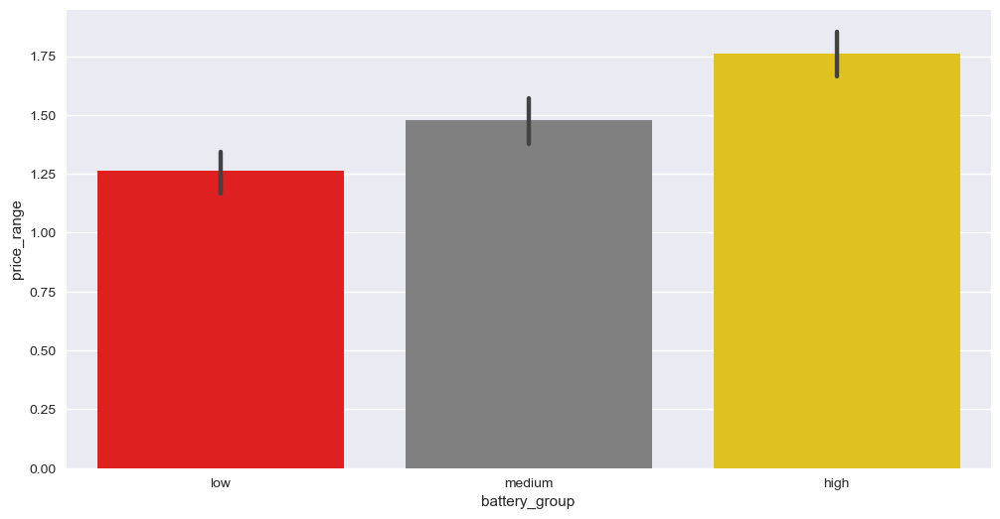

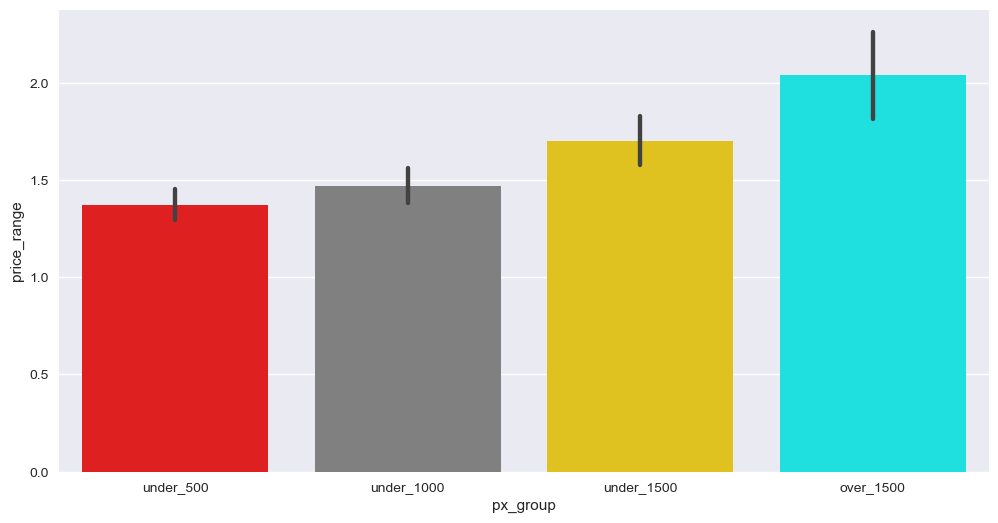

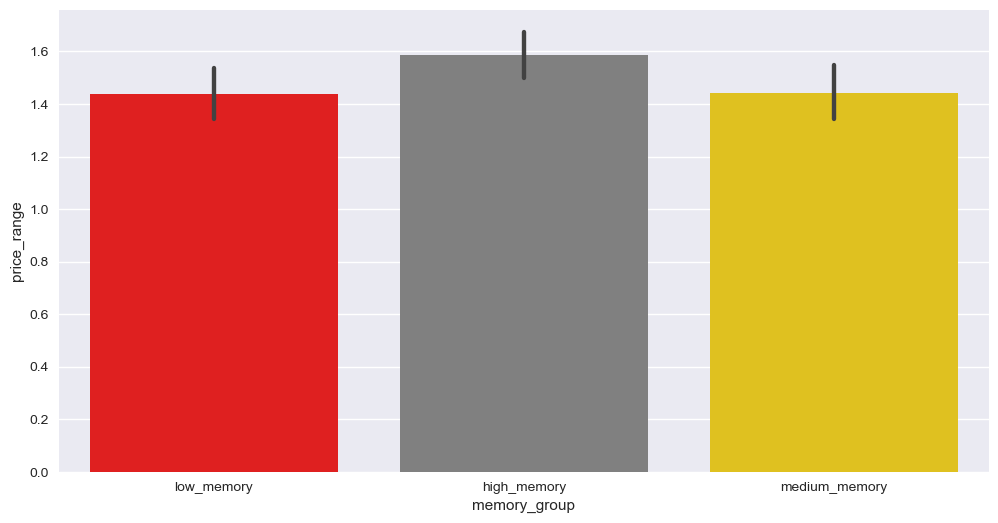

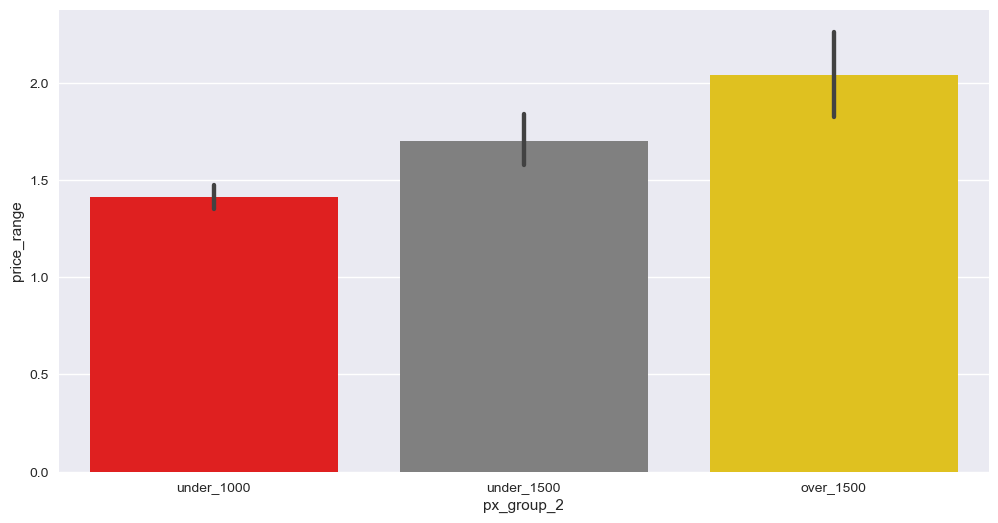

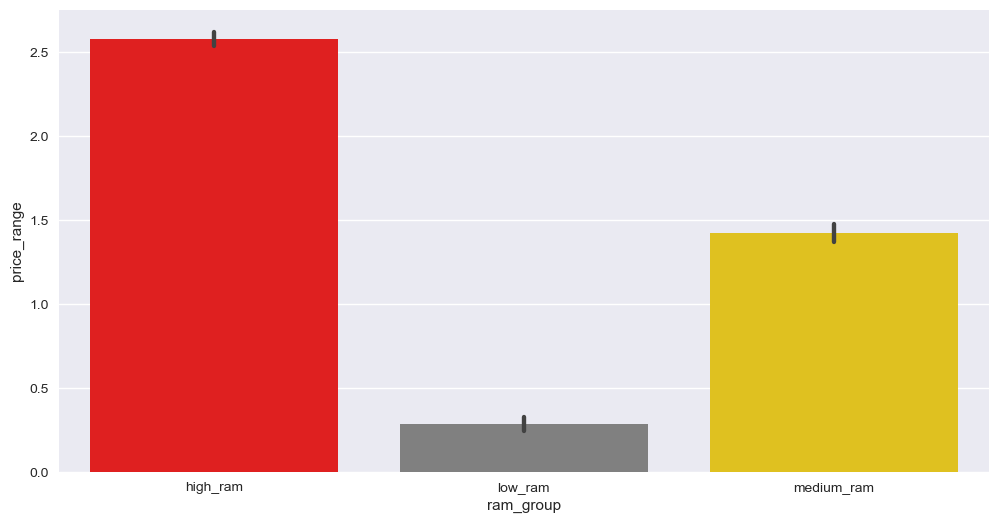

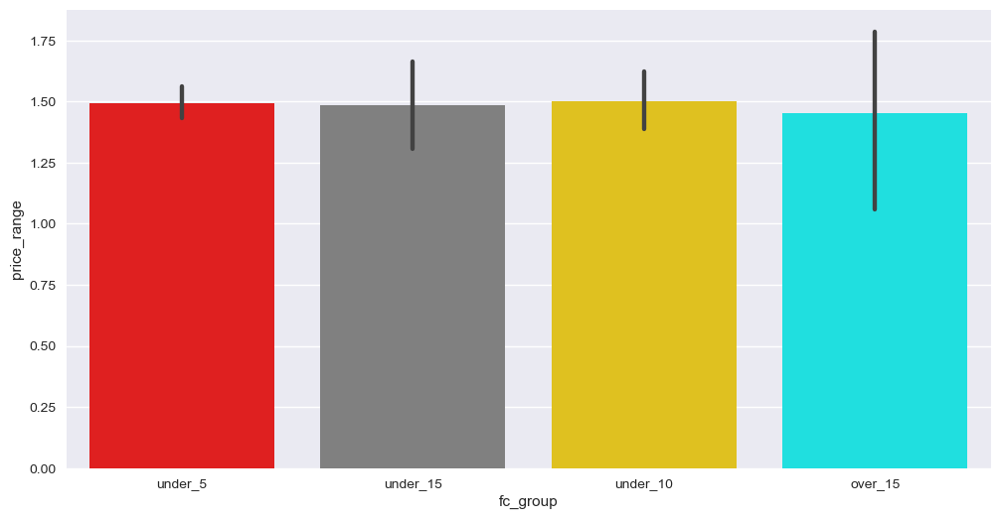

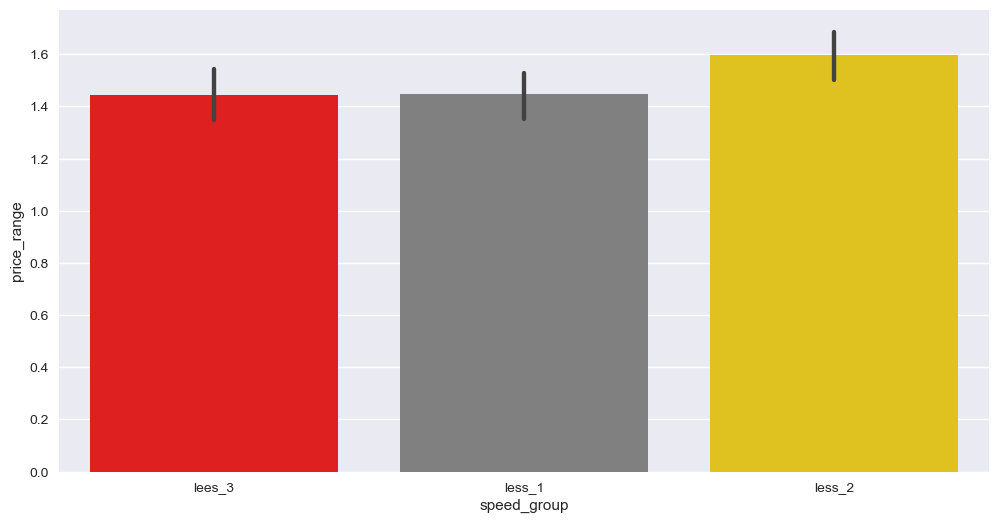

In [59]:
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue']
for i in range(7):
    fig = plt.figure(figsize=(12, 6))
    sns.barplot(y='price_range', x=df2.columns[i], data=df2, palette=custom_colors)

Analysis:
- Battery power groups exhibit a direct relationship with price, where higher power results in a higher price.
- Phones with a pixel resolution exceeding 1500 tend to be the most expensive.
- Higher memory capacity correlates with increased phone prices.
- Phones with greater RAM capacity tend to be more expensive.
- Price differences based on front camera quality are relatively minor.
- Phones with a clock speed less than 2 are typically the most expensive.

#### RAM- PRICE RANGE

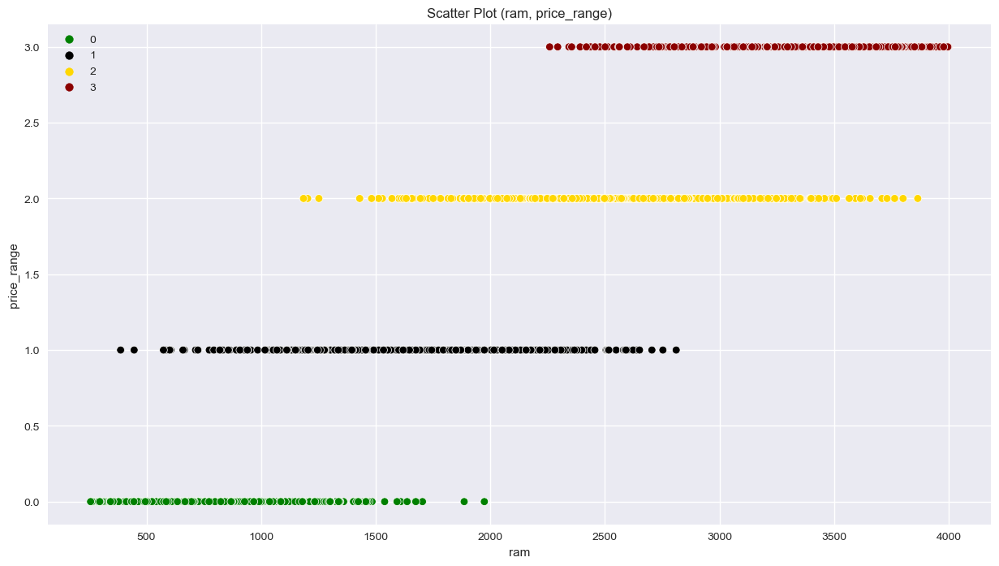

In [60]:
custom_colors = ["green", "black", "gold", "darkred"]
def scatter_plot(x, y, hue, data):
    plt.figure(1, figsize=(15, 8))
    sns.scatterplot(x=x, y=y, hue=hue, data=data, palette=custom_colors)
    plt.legend()
    plt.title(f'Scatter Plot ({x}, {y})')
    plt.show()
scatter_plot(x='ram', y='price_range', hue='price_range', data=df)


<AxesSubplot:xlabel='price_range', ylabel='ram'>

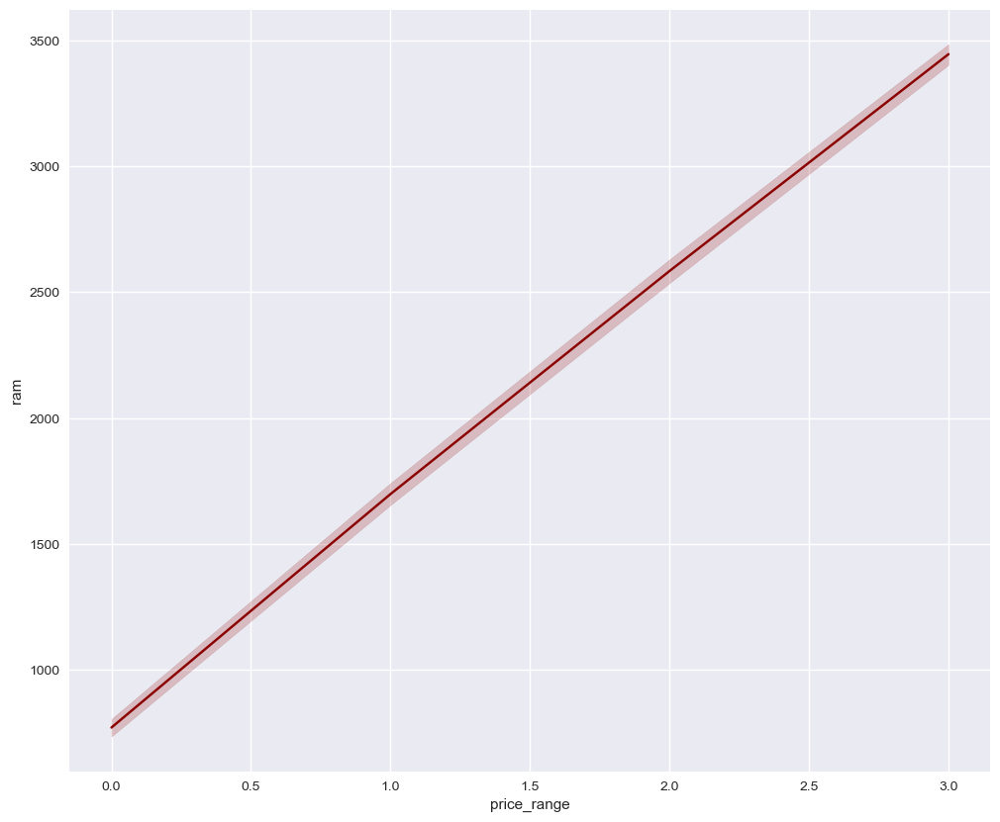

In [61]:
plt.figure(figsize=(12, 10))
sns.lineplot(x='price_range', y='ram', data=df, color='darkred')

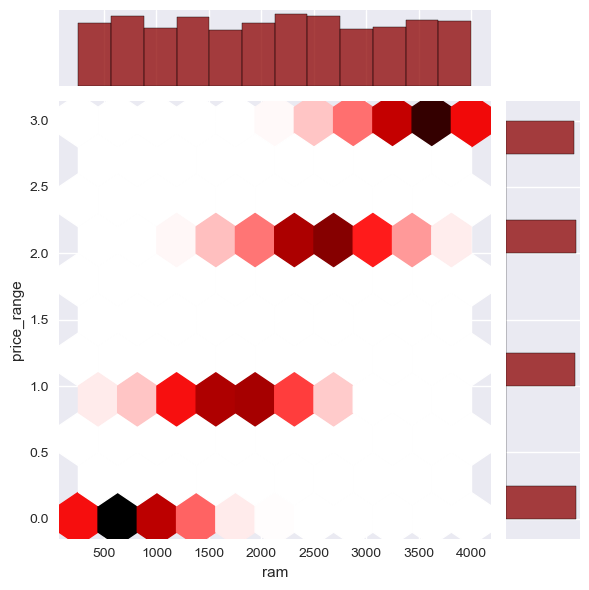

In [62]:
sns.jointplot(x='ram',y='price_range',data=df,color='darkred',kind='hex');

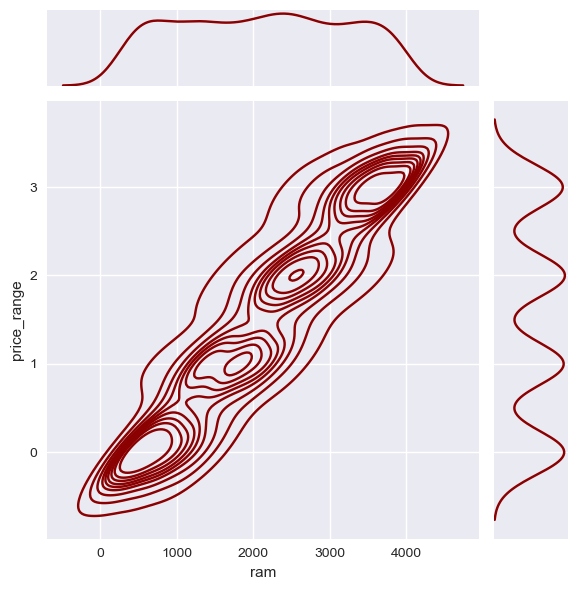

In [63]:
sns.jointplot(x='ram',y='price_range',data=df,color='darkred',kind='kde');

Analysis:
- The relationship between RAM and Price Range is evident, with higher RAM leading to increased mobile prices.

#### 4G-RAM- PRICE RANGE

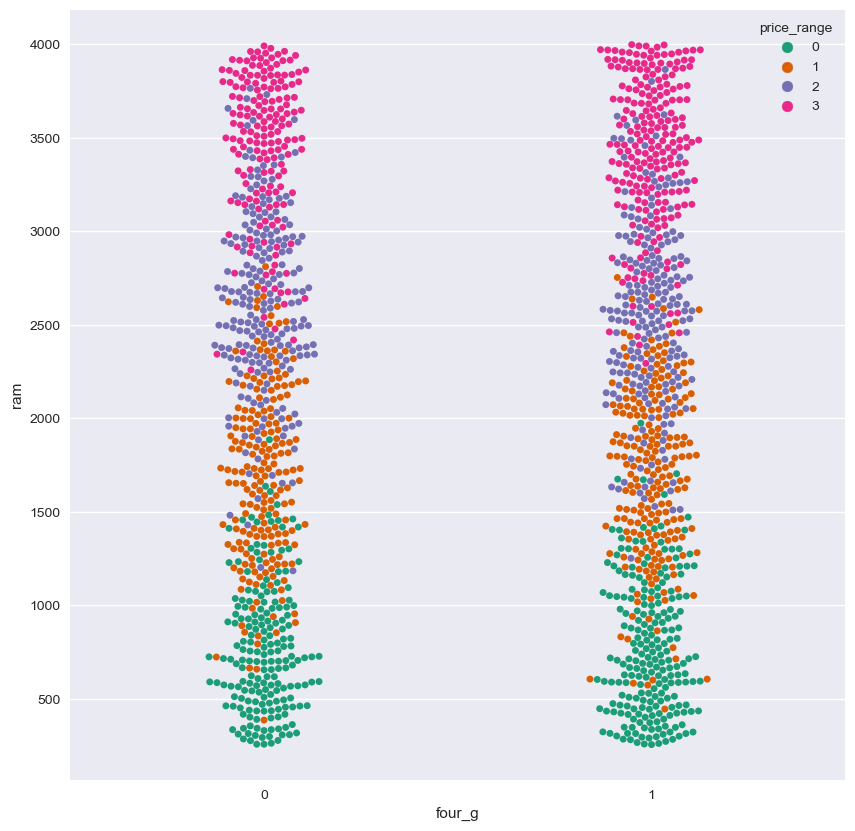

In [64]:
f, ax = plt.subplots(figsize=(10, 10))
ax=sns.swarmplot(x="four_g", y="ram", hue="price_range",
              palette="Dark2", data=df)
ax=sns.set(style="darkgrid")

#### 3G-RAM- PRICE RANGE

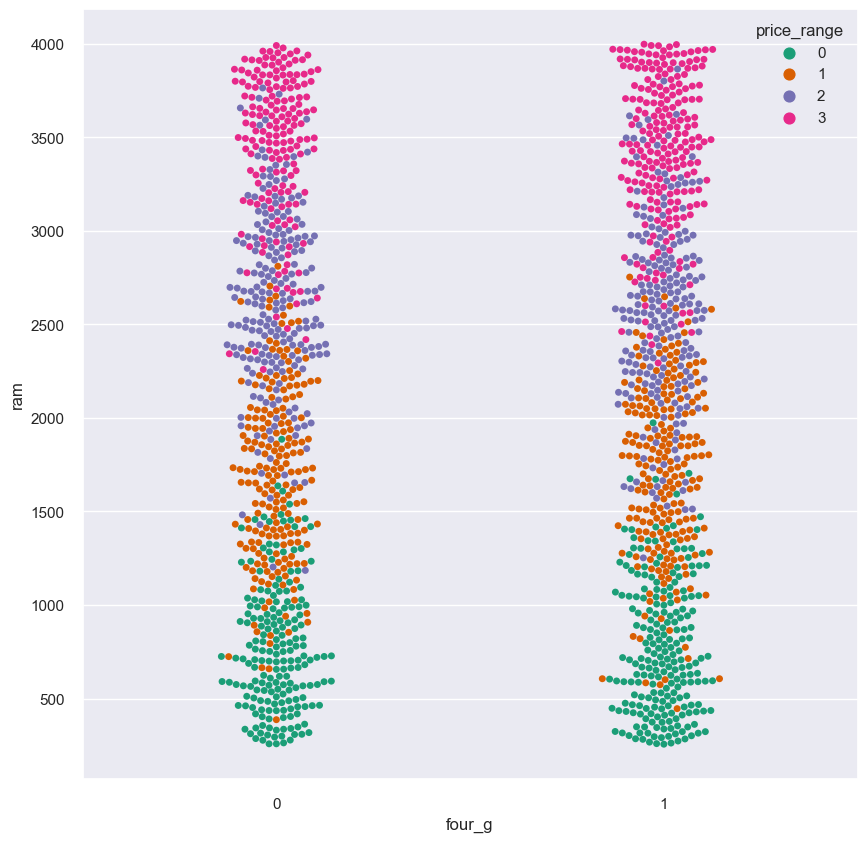

In [65]:
f, ax = plt.subplots(figsize=(10, 10))
ax=sns.swarmplot(x="four_g", y="ram", hue="price_range",
              palette="Dark2", data=df)
ax=sns.set(style="darkgrid")

#### -Battery power-RAM and Price Range

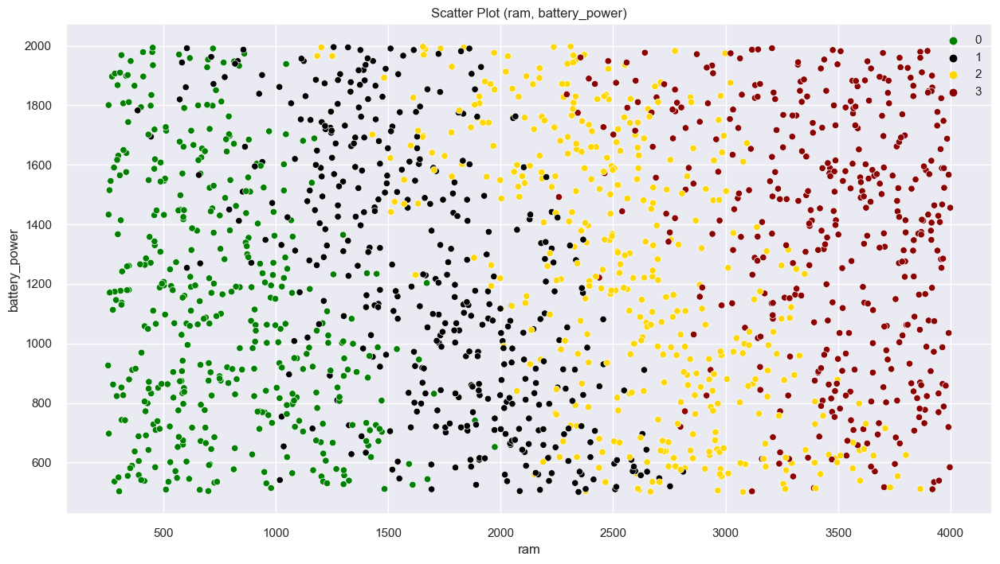

In [66]:
#compare battery power with RAM       
scatter_plot(x = 'ram' , y = 'battery_power' , hue = 'price_range' , data = df)

observation:
- mobile phone with RAM more than 3000 have a higher price

<AxesSubplot:xlabel='n_cores', ylabel='battery_power'>

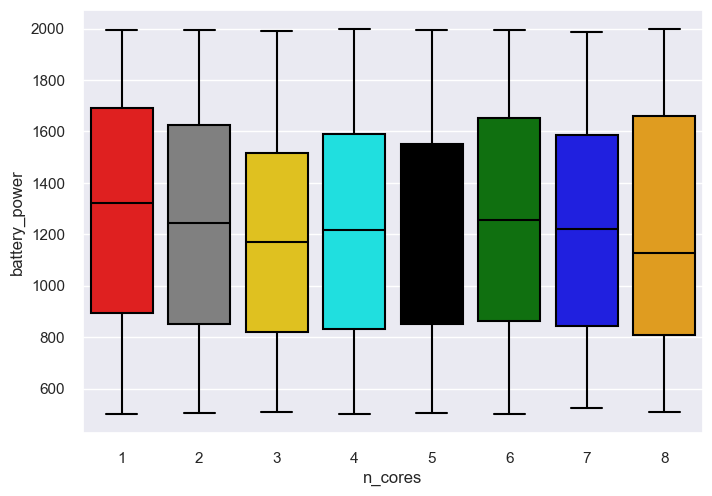

In [67]:
custom_colors = ["red", "gray", "gold", "cyan", "black", "green", "blue", "orange", "pink", "darkred"]
sns.boxplot(data=df, x=df['n_cores'], y=df['battery_power'], palette=custom_colors)

#### Camera mega pixels

Text(0.5, 0, 'MegaPixels')

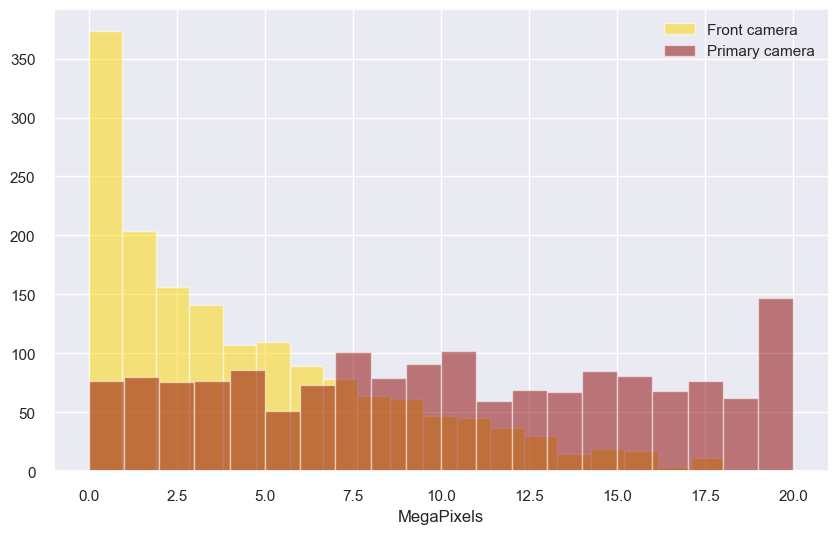

In [68]:
plt.figure(figsize=(10,6))
df['fc'].hist(alpha=0.5, color='gold', label='Front camera', bins=20)
df['pc'].hist(alpha=0.5, color='darkred', label='Primary camera', bins=20)
plt.legend()
plt.xlabel('MegaPixels')

#### pixel resolution

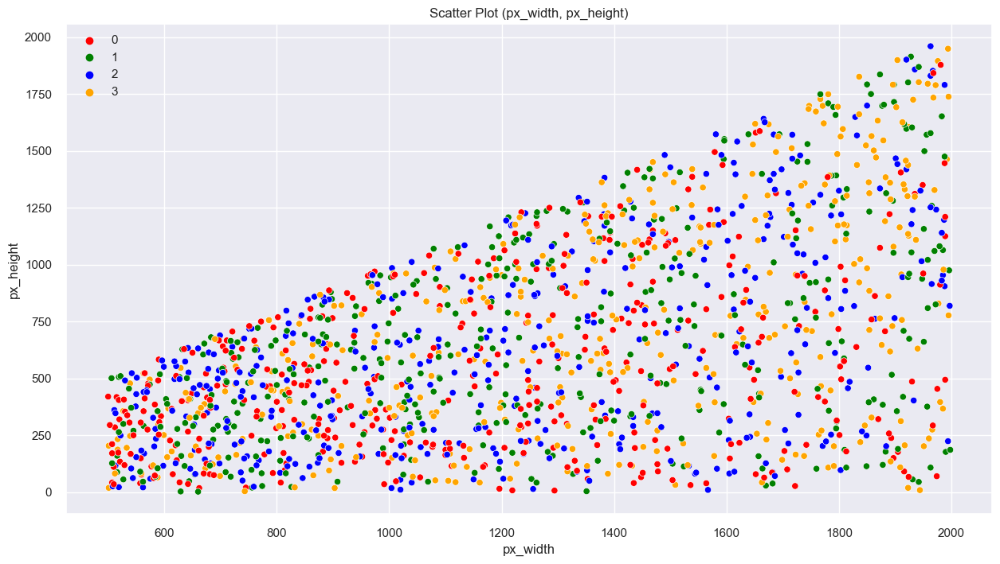

In [69]:
# Custom palette with four colors
custom_colors = ['red', 'green', 'blue', 'orange']
def scatter_plot(x, y, hue, data):
    plt.figure(1, figsize=(15, 8))
    sns.scatterplot(x=x, y=y, hue=hue, data=data, palette=custom_colors)
    plt.legend()
    plt.title(f'Scatter Plot ({x}, {y})')
    plt.show()
scatter_plot(x='px_width', y='px_height', hue='price_range', data=df)

#### Screen Width & Height

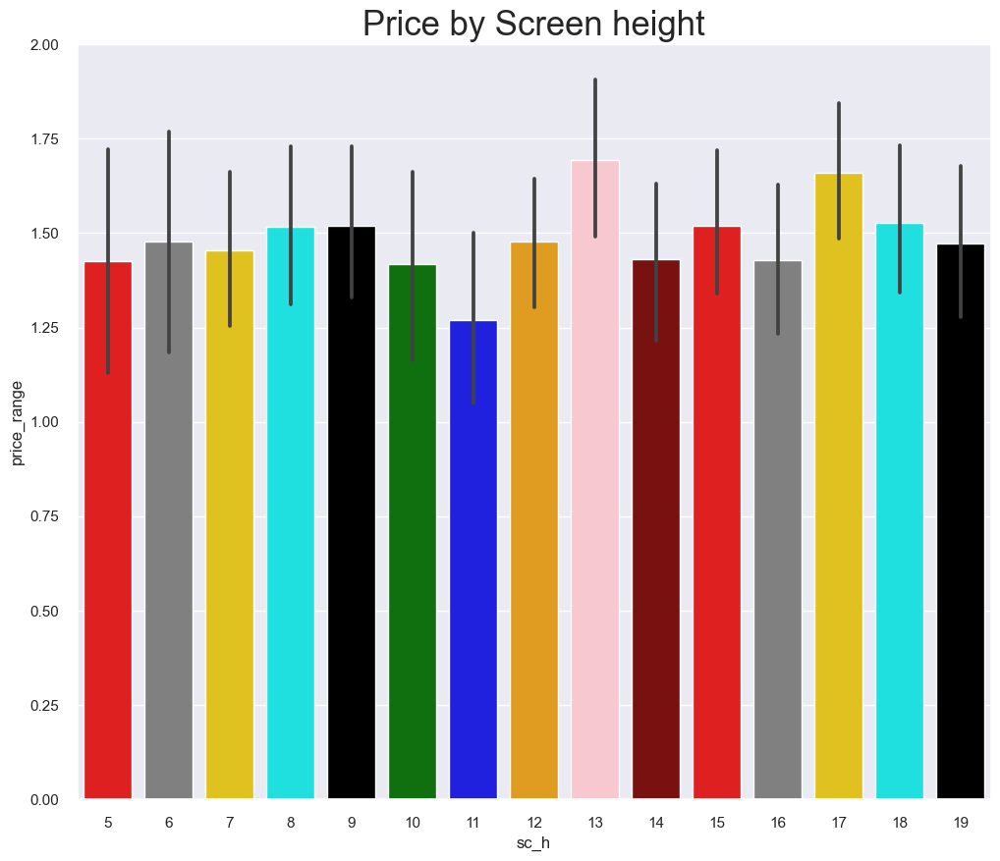

In [70]:
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue', 'orange', 'pink', 'darkred']
plt.figure(figsize=(12, 10))
sns.barplot(x="sc_h", y="price_range", data=df, palette=custom_colors)
plt.title("Price by Screen height", fontsize=25)
plt.show()

Analysis:
- There is no significant difference in price range according to screen height.

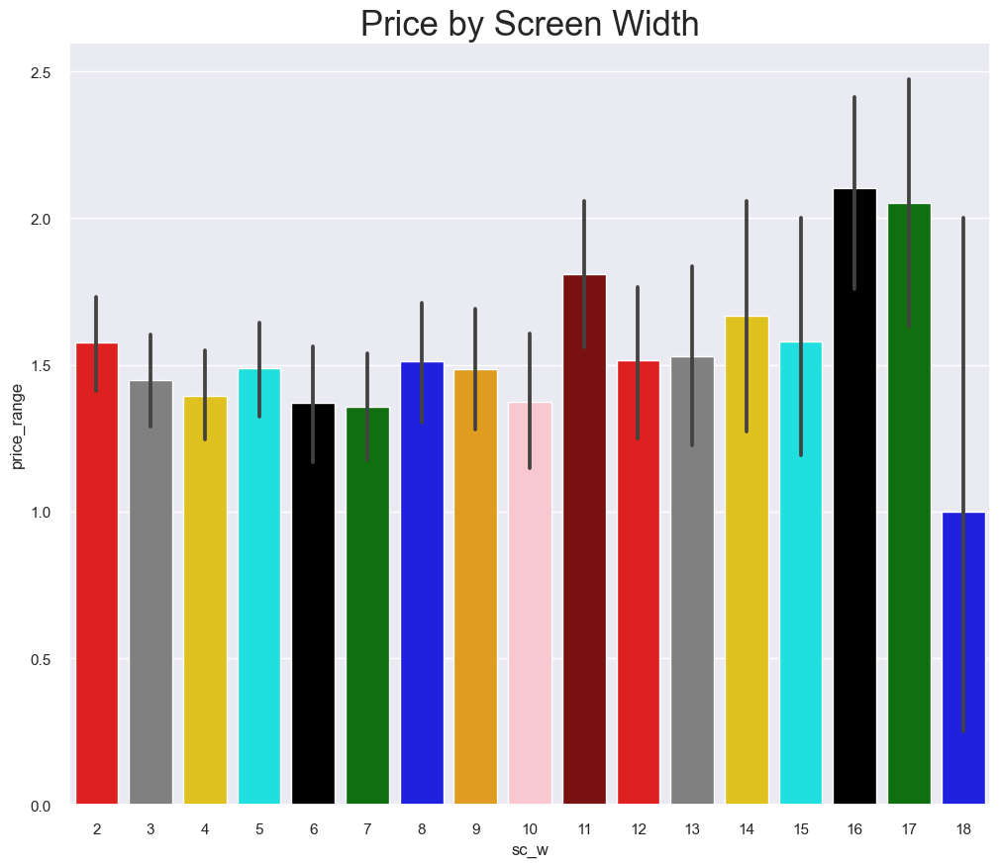

In [71]:
custom_colors = ['red', 'gray', 'gold', 'cyan', 'black', 'green', 'blue', 'orange', 'pink', 'darkred']
plt.figure(figsize=(12, 10))
sns.barplot(x="sc_w", y="price_range", data=df, palette=custom_colors)
plt.title("Price by Screen Width", fontsize=25)
plt.show()

observation
1. The difference in price range according to screen width and height is not noticeable

In [72]:
target_grp = df.groupby(['price_range'])

In [73]:
target_grp.describe(percentiles = [0.5])[nume_cols]

battery_power                                                  \
                    count         mean         std    min     50%     max   
price_range                                                                 
0            404.0         1124.242574  412.085774  503.0  1067.0  1994.0   
1            401.0         1206.471322  444.024447  501.0  1172.0  1996.0   
2            408.0         1231.578431  454.630161  501.0  1225.0  1998.0   
3            396.0         1374.267677  410.192655  503.0  1431.0  1992.0   

                fc                                     clock_speed            \
             count      mean       std  min  50%   max       count      mean   
price_range                                                                    
0            404.0  4.183168  4.220488  0.0  3.0  19.0  404.0       1.549505   
1            401.0  4.269327  4.525735  0.0  3.0  18.0  401.0       1.468828   
2            408.0  4.436275  4.314521  0.0  3.0  18.0  408.0       1.524510   
3            396.0  4.285354  4.264886  0.0  3.0  18.0  396.0       1.491919   

                                        ram                                   \
                  std  min  50%  max  count         mean         std     min   
price_range                                                                    
0            0.846933  0.5  1.6  3.0  404.0  770.507426   350.690411  256.0    
1            0.816915  0.5  1.4  3.0  401.0  1698.137157  467.847137  387.0    
2            0.796946  0.5  1.5  3.0  408.0  2584.431373  494.065922  1185.0   
3            0.780513  0.5  1.5  3.0  396.0  3446.171717  398.742372  2259.0   

                            talk_time                                        \
                50%     max     count       mean       std  min   50%   max   
price_range                                                                   
0            709.5   1974.0  404.0     10.638614  5.435669  2.0  10.0  20.0   
1            1719.0  2811.0  401.0     11.314214  5.650754  2.0  12.0  20.0   
2            2580.0  3865.0  408.0     10.950980  5.377864  2.0  11.0  20.0   
3            3500.0  3998.0  396.0     11.017677  5.438465  2.0  11.0  20.0   

            int_memory                                         m_dep  \
                 count       mean        std  min   50%   max  count   
price_range                                                            
0            404.0      30.633663  17.975430  2.0  29.0  64.0  404.0   
1            401.0      32.867830  17.975956  2.0  33.0  64.0  401.0   
2            408.0      31.399510  18.574234  2.0  30.0  64.0  408.0   
3            396.0      34.345960  18.169776  2.0  35.0  64.0  396.0   

                                               mobile_wt              \
                 mean       std  min  50%  max     count        mean   
price_range                                                            
0            0.488119  0.284169  0.1  0.5  1.0  404.0     140.569307   
1            0.522943  0.289693  0.1  0.5  1.0  401.0     139.057357   
2            0.494363  0.288677  0.1  0.5  1.0  408.0     144.321078   
3            0.496717  0.293929  0.1  0.5  1.0  396.0     136.333333   

                                               pc                            \
                   std   min    50%    max  count       mean       std  min   
price_range                                                                   
0            36.921520  80.0  142.5  200.0  404.0  9.715347   6.119623  0.0   
1            35.540459  80.0  138.0  200.0  401.0  9.875312   6.023239  0.0   
2            33.716368  80.0  146.0  200.0  408.0  10.022059  5.908558  0.0   
3            35.136335  80.0  136.0  200.0  396.0  9.747475   5.921159  0.0   

                        px_height                                       \
              50%   max     count        mean         std   min    50%   
price_range                                                              
0         

Analysis:
- There is a nearly linear correlation between the "battery_power" values and the target classes.
- Surprisingly, target class 0 exhibits the highest mean value for "clock_speed"!
- The highest mean value of "int_memory" belongs to target class 3.
- Target class 3 also has the lowest mean value for "mobile_wt," which is logically consistent.
- The "pc" column shows a linear correlation with the target classes.
- The highest mean value for "px_height" is associated with target class 3.
- Target class 3 also boasts the highest mean value for "px_width," indicating that more expensive phones have superior screen resolution in terms of pixel size.
- There is a strong positive correlation between the "ram" values and the target classes.
- The mean value of "sc_h" is highest among samples in target class 3. However, for other classes, there is no clear logical relationship.

# Correlation

<AxesSubplot:>

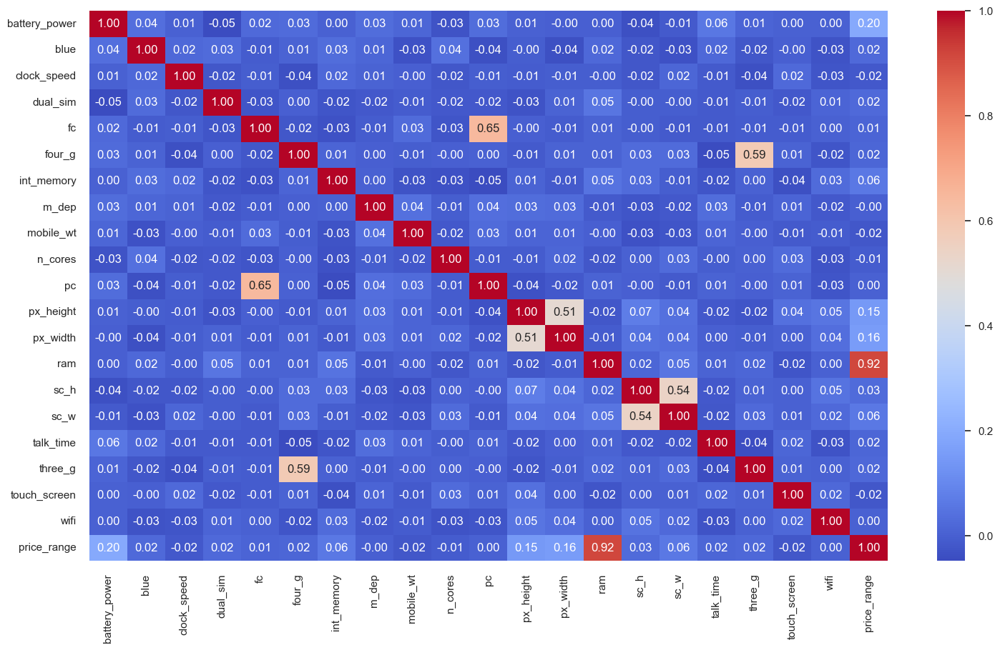

In [74]:
plt.figure(figsize=(18, 10))
custom_colors = sns.color_palette("coolwarm", as_cmap=True)
sns.heatmap(df.corr(), cmap=custom_colors, annot=True, fmt='.2f')

In [75]:
# checking correlation of independent variable with dependent variable i.e personal_loan
df.corr()['price_range'].sort_values(ascending=False)

price_range      1.000000
ram              0.917330
battery_power    0.196288
px_width         0.155291
px_height        0.145118
int_memory       0.058975
sc_w             0.058899
sc_h             0.027184
dual_sim         0.022609
blue             0.022046
three_g          0.019767
talk_time        0.015909
four_g           0.015621
fc               0.012357
pc               0.004713
wifi             0.004313
m_dep           -0.000956
n_cores         -0.008647
clock_speed     -0.016139
touch_screen    -0.020838
mobile_wt       -0.022835
Name: price_range, dtype: float64

Analysis from the Heatmap:
- There is a strong positive correlation between RAM and the target price range. As RAM size increases, the price range tends to be higher.
Several features exhibit strong positive correlations:
- 3G and 4G support
- Primary Camera mega pixels (pc) and Front Camera mega pixels (fc)
- Pixel Resolution Width (px_width) and Pixel Resolution Height (px_height)
- Screen Width of mobile in cm (sc_w) and Screen Height of mobile in cm (sc_h)
- The positive correlations indicate that these pairs of features tend to increase or decrease together. For example, when the screen width of a mobile (sc_w) increases, the screen height (sc_h) also tends to increase.

#  Modeling

### DECISION TREE CLASSIFIER (DTs)

In [76]:
# independant variables
x=df.drop(["price_range"],axis=1)
y = df["price_range"].values.reshape(-1,1)  #target
print('shape of x : {} \nshape of y : {}'.format(x.shape , y.shape))

shape of x : (1609, 20) 
shape of y : (1609, 1)


In [77]:
# Returning the classification metrics for multi_class probelm.

def Report(y_test , y_pred):
    print('Accuracy : {}% \n'.format(accuracy_score(y_test , y_pred)*100))
    print('Confusion Matrix : \n\n{}\n'.format(confusion_matrix(y_test , y_pred)))
    print('Classification Report : \n\n{}'.format(classification_report(y_test , y_pred)))
    
def multi_class_metrics(y_true, y_pred):
    print(f'Accuracy  : ', round(metrics.accuracy_score(y_true, y_pred), 3))
    print(f'Precision : ', round(metrics.precision_score(y_true, y_pred, average = 'micro'), 3))
    print(f'Recall    : ', round(metrics.recall_score(y_true, y_pred, average = 'micro'), 3))
    print(f'f1        : ', round(metrics.f1_score(y_true, y_pred, average = 'micro'), 3))    

In [78]:
def DTs_Model(x, y, test_size, M_depth, Criterion):

    global x_train , x_test , y_train , y_test , y_pred
    
    rows = []
    
    for n in test_size:
        x_train , x_test , y_train , y_test = train_test_split(x , y , test_size = n , random_state = 0)
        
        for maxDepth in M_depth:
            
            for c in Criterion:
                
                # Create Decision Tree classifer model
                DTs = DecisionTreeClassifier(max_depth = maxDepth, criterion=c)
            
                # fit model for train data
                DTs = DTs.fit(x_train,y_train)
 
                #Predict the response for test dataset
                y_pred = DTs.predict(x_test)
        
                dataset = {'Test_size': n, 'Max_depth': maxDepth, 'Criterion':c , 'acc': metrics.accuracy_score(y_test, y_pred), 'score': DTs.score(x, y)}
                rows.append(dataset)
                evaluation = pd.DataFrame(rows) 
            
                       
            
    return (evaluation)   
# We want to hightlight the maximume values
def highlight_max(s):
    is_max = s == s.max()
    return ['background-color: green' if v else '' for v in is_max]

In [79]:
evaluation = DTs_Model(x, y, [0.1, 0.15, 0.2, 0.25,0.3], np.arange(1, 20),['gini', 'entropy'])
evaluation.style.apply(highlight_max)

,Test_size,Max_depth,Criterion,acc,score
0,0.100000,1,gini,0.521739,0.497203
1,0.100000,1,entropy,0.521739,0.497203
2,0.100000,2,gini,0.776398,0.766314
3,0.100000,2,entropy,0.770186,0.766314
4,0.100000,3,gini,0.788820,0.775637
5,0.100000,3,entropy,0.770186,0.766314
6,0.100000,4,gini,0.838509,0.839030
7,0.100000,4,entropy,0.826087,0.817278
8,0.100000,5,gini,0.819876,0.882536
9,0.100000,5,entropy,0.788820,0.874456


- test size=0.1
- max_depth=14
- Criterion= gini

In [80]:
#split X and y in training and test set in 90:10 ratio
x_train , x_test , y_train , y_test = train_test_split(x , y , test_size = 0.1 , random_state = 0)
print('shape of x_train :',x_train.shape)
print('shape of y_train :',y_train.shape)
print('shape of x_test :',x_test.shape)
print('shape of y_test :',y_test.shape)

shape of x_train : (1448, 20)
shape of y_train : (1448, 1)
shape of x_test : (161, 20)
shape of y_test : (161, 1)


In [81]:
DTs = DecisionTreeClassifier(max_depth =14, criterion='gini',random_state = 0)
DTs = DTs.fit(x_train,y_train)
y_pred = DTs.predict(x_test)

### Evaluation

In [82]:
Report(y_test , y_pred)

Accuracy : 84.472049689441% 

Confusion Matrix : 

[[35  5  0  0]
 [ 3 29  6  0]
 [ 0  7 30  2]
 [ 0  0  2 42]]

Classification Report : 

              precision    recall  f1-score   support

           0       0.92      0.88      0.90        40
           1       0.71      0.76      0.73        38
           2       0.79      0.77      0.78        39
           3       0.95      0.95      0.95        44

    accuracy                           0.84       161
   macro avg       0.84      0.84      0.84       161
weighted avg       0.85      0.84      0.85       161



In [83]:
print('f1 score is:', metrics.f1_score(y_test, y_pred,average="macro"))

f1 score is: 0.8413448365980011


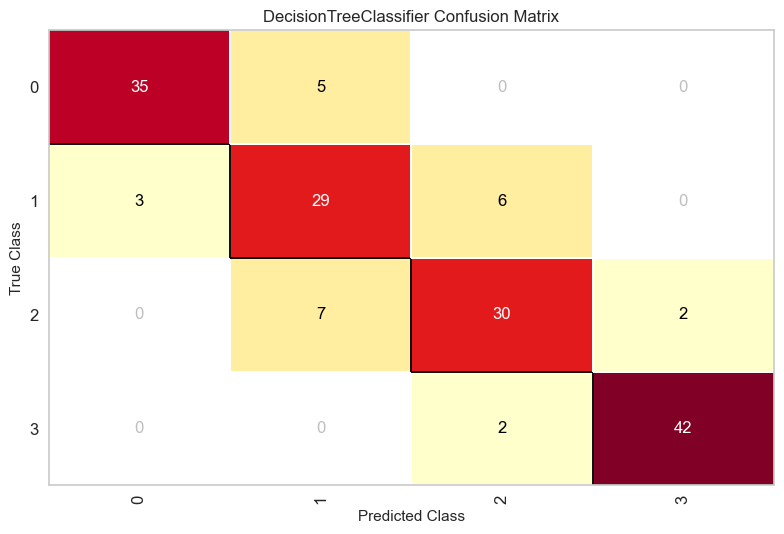

<AxesSubplot:title={'center':'DecisionTreeClassifier Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [84]:
from yellowbrick.classifier import ConfusionMatrix

cm = ConfusionMatrix(
    DTs, classes=[0,1,2,3])


cm.fit(x_train, y_train)
cm.score(x_test, y_test)

cm.poof()

- DTs model predict 42+30+29+35= 136 samples correctly.
- DTs model predict 2+2+7+6+3+5= 25 samples uncorectly 

###  Use Cross Validation

In [85]:
def Perform_cross_val(model, k, x, y, scoring):
    """
    perform cross validation
        model: model
        k(scaler): the value for n_splits in KFold()
        x(DataFrame or array):  x_train
        y(DataFrame or array): y_train
        scoring(string): an approach for evaluation in cross validation
    """

    kf = StratifiedKFold(n_splits=k)
    cv_results = cross_val_score(model, x, y.ravel(), cv=kf, scoring=scoring)
    cv_mean = np.mean(cv_results)
    
    print('-'*20, f"CV for k={k}, scoring={scoring}", '-'*20)
    print(f"CV mean: {cv_mean}")
    print(f"CV results: {cv_results}\n")

In [86]:
# Check cross validation on DTs model to estimate model performance (Accuracy)
# use MinMaxScaler 
pipe1 = Pipeline([('scaler', MinMaxScaler()), ('DTs', DecisionTreeClassifier())])
Perform_cross_val(pipe1, k=5, x=x_train, y=y_train, scoring='accuracy')

-------------------- CV for k=5, scoring=accuracy --------------------
CV mean: 0.8183868273475718
CV results: [0.81034483 0.79310345 0.82758621 0.82698962 0.83391003]



- scores of all fold are good.

### MODEL WITH GRIDSEARCHCV

- To apply DTs algorithm firstly I used GridSearchCV method to tune parameters. Some parameters are given below. 

In [87]:
#split X and y in training and test set in 90:10 ratio
x_train , x_test , y_train , y_test = train_test_split(x , y , test_size = 0.1 , random_state = 0)


In [88]:
DTs2 = DecisionTreeClassifier()

In [89]:
max_depth = range(2,21,1)
criterion = ['entropy', 'gini']
min_samples_leaf:range(1,15,1)
min_samples_split:range(2,20,1)     
random_state =range(0,1)

parameters = {'max_depth': max_depth , 'criterion':criterion ,"min_samples_leaf":range(1,15,1),
              "min_samples_split":range(2,20,1),'random_state':random_state}
gridsearch = GridSearchCV(estimator = DTs2,
                         param_grid = parameters,
                         scoring = 'accuracy',
                         cv = 5,
                         verbose = 1,
                         n_jobs = -1)
gridsearch.fit(x_train,y_train)

Fitting 5 folds for each of 9576 candidates, totalling 47880 fits


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['entropy', 'gini'],
                         'max_depth': range(2, 21),
                         'min_samples_leaf': range(1, 15),
                         'min_samples_split': range(2, 20),
                         'random_state': range(0, 1)},
             scoring='accuracy', verbose=1)

In [90]:
print(gridsearch.best_params_)

{'criterion': 'gini', 'max_depth': 9, 'min_samples_leaf': 7, 'min_samples_split': 16, 'random_state': 0}


No lets build the model with the best parameters we have found with the Gridsearch method.

In [91]:
DTs2 = DecisionTreeClassifier(criterion='gini', max_depth= 9, min_samples_leaf= 7, min_samples_split= 16, random_state= 0)
DTs2 = DTs2.fit(x_train,y_train)
y_pred = DTs2.predict(x_test)

### Evaluation

In [92]:
Report(y_test , y_pred)

Accuracy : 88.19875776397515% 

Confusion Matrix : 

[[37  3  0  0]
 [ 4 32  2  0]
 [ 0  7 31  1]
 [ 0  0  2 42]]

Classification Report : 

              precision    recall  f1-score   support

           0       0.90      0.93      0.91        40
           1       0.76      0.84      0.80        38
           2       0.89      0.79      0.84        39
           3       0.98      0.95      0.97        44

    accuracy                           0.88       161
   macro avg       0.88      0.88      0.88       161
weighted avg       0.89      0.88      0.88       161



In [93]:
print('f1 score is:', metrics.f1_score(y_test, y_pred,average="macro"))

f1 score is: 0.8792338315326821


- score of model increase after use Grid search CV parameters 

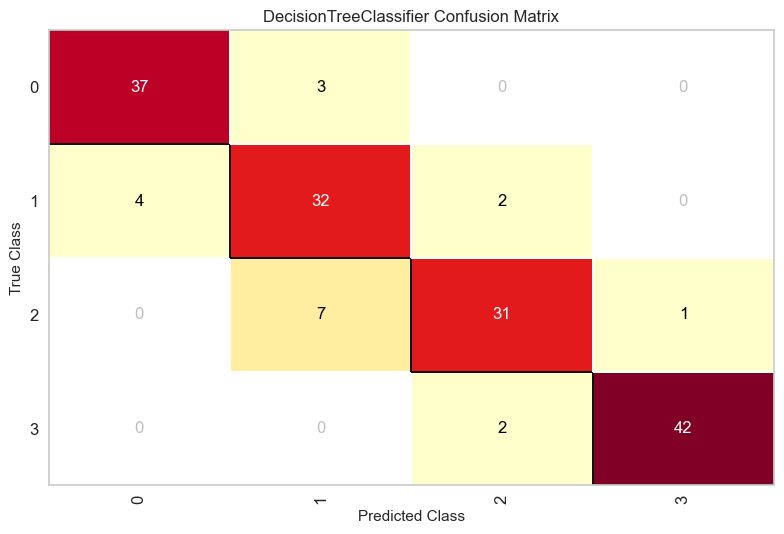

<AxesSubplot:>

In [94]:
# Define custom colors for the Confusion Matrix
colors = ['orange', 'blue', 'green', 'red']
cm = ConfusionMatrix(DTs2, classes=[0, 1, 2, 3])
cm.fit(x_train, y_train)
cm.score(x_test, y_test)
# Set the custom colors for the Confusion Matrix
cm.poof(outpath=None, clear_figure=True, colors=colors)

- DTs2 model predict 42+31+32+37= 142 samples correctly.
- DTs2 model predict 2+2+7+6+3+5= 19 samples uncorectly 

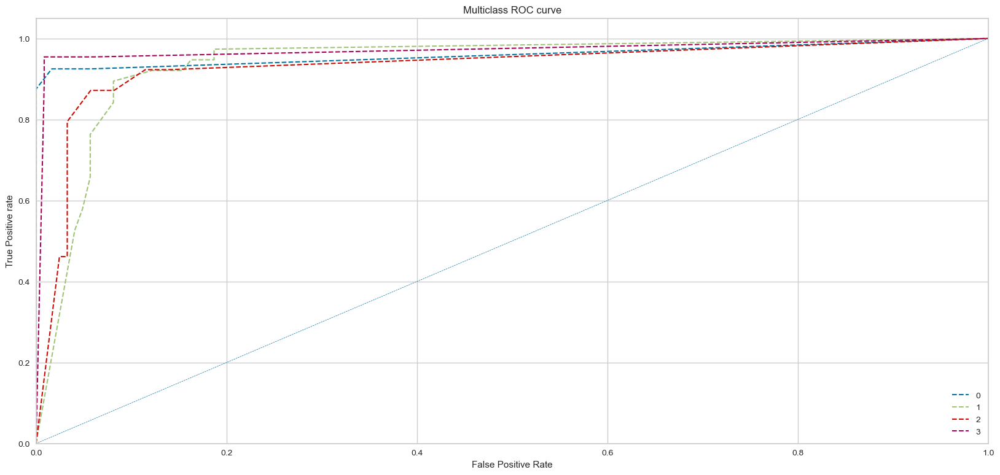

In [95]:
y_Pred_prob = DTs2.predict_proba(x_test)
def roc_curve_plot(y_actual , y_predicted_probs):
    
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = dict()

    n_class = np.unique(y_actual).shape[0]
    y_lb = label_binarize(y_test , classes = np.unique(y_actual))

    plt.figure(1 , figsize = (20 , 9))
    for i in range(n_class):
        
        fpr[i] , tpr[i] , thres[i] = roc_curve(y_lb[: , i] , y_predicted_probs[: , i])
        plt.plot(fpr[i] , tpr[i] , '--' , linewidth = 1.5,  label = '{}'.format(i))
    
    plt.plot([0 , 1] , [0 ,1] , 'b--' , linewidth = 0.5)
    plt.xlim([0 , 1])
    plt.ylim([0 , 1.05])
    plt.title('Multiclass ROC curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive rate')
    plt.legend(loc='lower right')
    plt.show()
    
roc_curve_plot(y_test , y_Pred_prob)

- Best Decision Tree : DTs2
* Hyperparameters : criterion='gini', max_depth= 9, min_samples_leaf= 7, min_samples_split= 16, random_state= 0
* Accuracy = 88.20%

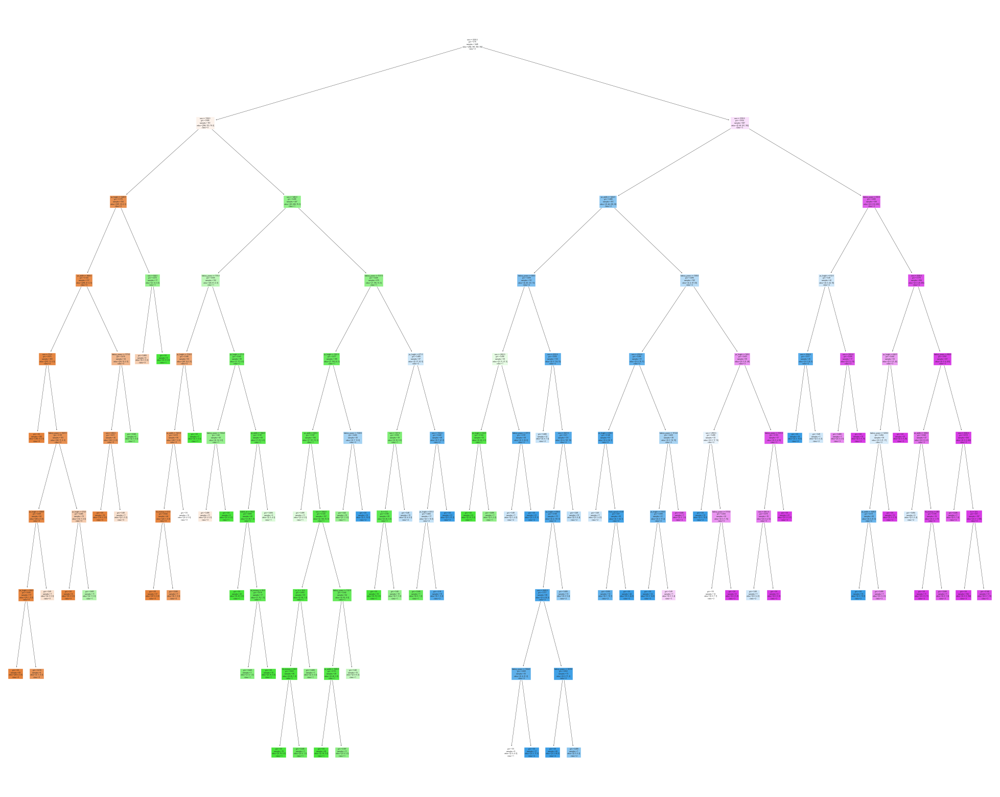

In [96]:
# visualizing tree
from sklearn import tree
feature_names = x.columns
target_names = ['0', '1','2','3']
fig = plt.figure(figsize=(25,20))
plot= tree.plot_tree (DTs2,
                     feature_names=feature_names,
                     class_names=target_names,
                     filled=True) 
plt.show()

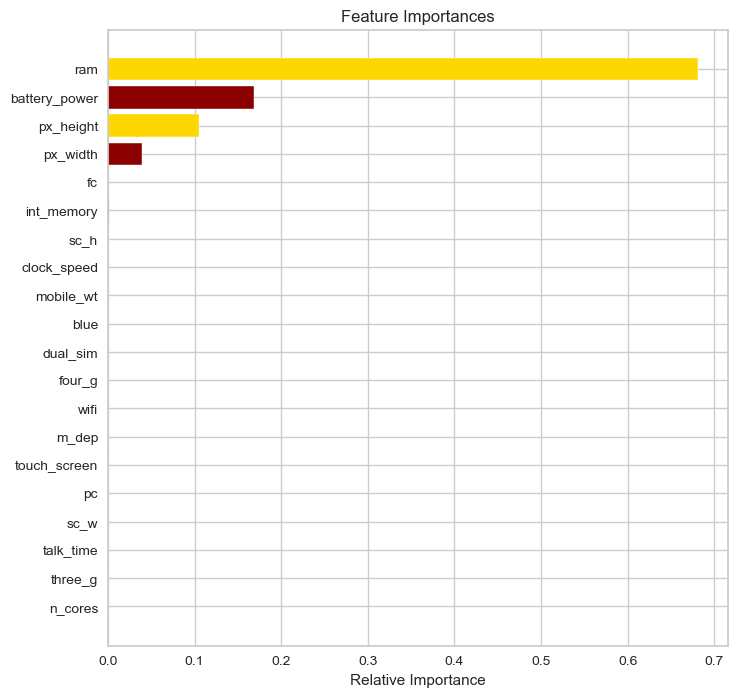

In [97]:
importances = DTs2.feature_importances_
indices = np.argsort(importances)
plt.figure(figsize=(8,8))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color=['darkred','gold'], align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

### RANDOM FOREST (RF)

In [98]:
# independant variables
x=df.drop(["price_range"],axis=1)
y = df["price_range"].values.reshape(-1,1)  #target
print('shape of x : {} \nshape of y : {}'.format(x.shape , y.shape))

shape of x : (1609, 20) 
shape of y : (1609, 1)


In [99]:
def RF_Model(x, y, testSize, n_estimators, Criterion):

    global x_train , x_test , y_train , y_test , y_pred
    
    rows = []
    
    for n in testSize:
        x_train , x_test , y_train , y_test = train_test_split(x , y , test_size = n , random_state = 0)
        
        for max_estimator in n_estimators:
            
            for c in Criterion:
                
                # Create Random Forest classifer object
                RF = RandomForestClassifier(n_estimators = max_estimator, criterion=c)
            
                # fit on Train  Random Forest Classifer
                RF = RF.fit(x_train,y_train.ravel())
 
                #Predict test data
                y_pred = RF.predict(x_test)
        
                dataset= {'Test_size': n, 'n_estimators': max_estimator, 'Criterion':c , 'acc': metrics.accuracy_score(y_test, y_pred), 'score': RF.score(x, y)}
                rows.append(dataset)
                evaluation2 = pd.DataFrame(rows)            
            
    return (evaluation2)   
# We want to hightlight the maximume values
def highlight_max(s):
    is_max = s == s.max()
    return ['background-color: green' if v else '' for v in is_max]

In [100]:
evaluation2 = RF_Model(x, y, [0.1, 0.15, 0.2, 0.25,0.3], [50, 100, 170, 200, 300, 400], ['gini', 'entropy'])
evaluation2.style.apply(highlight_max)

,Test_size,n_estimators,Criterion,acc,score
0,0.100000,50,gini,0.900621,0.990056
1,0.100000,50,entropy,0.900621,0.990056
2,0.100000,100,gini,0.875776,0.987570
3,0.100000,100,entropy,0.881988,0.988191
4,0.100000,170,gini,0.900621,0.990056
5,0.100000,170,entropy,0.900621,0.990056
6,0.100000,200,gini,0.888199,0.988813
7,0.100000,200,entropy,0.894410,0.989434
8,0.100000,300,gini,0.906832,0.990677
9,0.100000,300,entropy,0.888199,0.988813


- test size=0.1
- n_estimators=170
- Criterion= gini

In [101]:
#split X and y in training and test set in 90:10 ratio
x_train , x_test , y_train , y_test = train_test_split(x , y , test_size = 0.1 , random_state = 0)
print('shape of x_train :',x_train.shape)
print('shape of y_train :',y_train.shape)
print('shape of x_test :',x_test.shape)
print('shape of y_test :',y_test.shape)

shape of x_train : (1448, 20)
shape of y_train : (1448, 1)
shape of x_test : (161, 20)
shape of y_test : (161, 1)


In [102]:
# n_estimators=100
# Criterion= gini
RF = RandomForestClassifier(n_estimators=170, criterion='gini',random_state = 0)
RF = RF.fit(x_train,y_train)
y_pred = RF.predict(x_test)

### Evaluation

In [103]:
Report(y_test , y_pred)

Accuracy : 92.54658385093167% 

Confusion Matrix : 

[[38  2  0  0]
 [ 3 33  2  0]
 [ 0  3 35  1]
 [ 0  0  1 43]]

Classification Report : 

              precision    recall  f1-score   support

           0       0.93      0.95      0.94        40
           1       0.87      0.87      0.87        38
           2       0.92      0.90      0.91        39
           3       0.98      0.98      0.98        44

    accuracy                           0.93       161
   macro avg       0.92      0.92      0.92       161
weighted avg       0.93      0.93      0.93       161



In [104]:
print('f1 score is:', metrics.f1_score(y_test, y_pred,average="macro"))

f1 score is: 0.9232640734833717


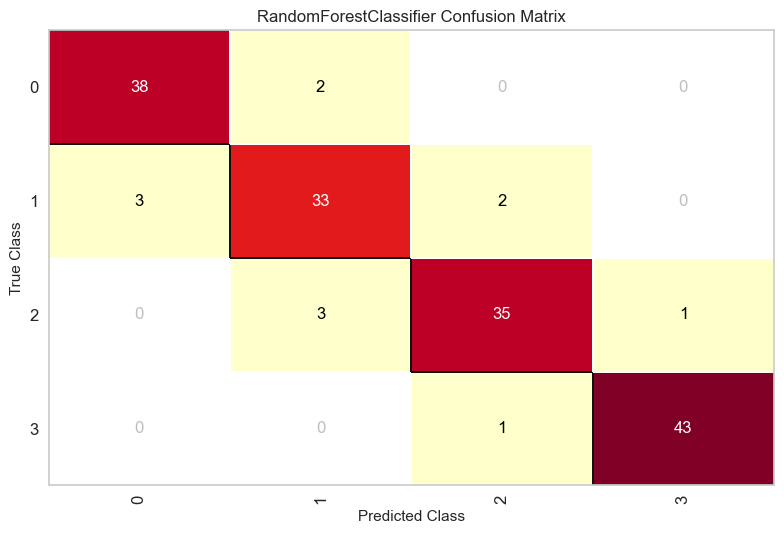

<AxesSubplot:title={'center':'RandomForestClassifier Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [105]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(
    RF, classes=[0,1,2,3])


cm.fit(x_train, y_train)
cm.score(x_test, y_test)

cm.poof()

- According to confusion matrix model knows yellow boxes wrong. 

- RF model predict 43+35+33+38= 149 samples correctly.
- RF model predict 1+1+3+2+3+2= 12 samples uncorectly 

### Use Cross Validation

In [106]:
# Check cross validation on DTs model to estimate model performance (Accuracy)
# use MinMaxScaler 
pipe2 = Pipeline([('RF', RandomForestClassifier())])
Perform_cross_val(pipe2, k=5, x=x_train, y=y_train, scoring='accuracy')

-------------------- CV for k=5, scoring=accuracy --------------------
CV mean: 0.859811478343873
CV results: [0.86206897 0.84827586 0.86206897 0.85467128 0.87197232]



- scores of all fold are good

### MODEL WITH GRIDSEARCHCV


- To apply RF algorithm firstly I used GridSearchCV method to tune parameters. Some parameters are given below. 

In [107]:
'''RF classifier pipeline'''
randomforestCLF = Pipeline(steps = [('scaler' , StandardScaler()) , 
                                    ('rf' , RandomForestClassifier(criterion = 'gini' , n_jobs = -1))])

'''parameters'''
parameters_rf = {'rf__n_estimators':[10 , 100 ,170,200, 250 , 300 , 400 ,  500 , 700],
                 'rf__max_depth' : [ None , 4 , 8  , 10 , 12] ,
                 'rf__min_samples_split': [2,3,4,5,6],
                 'rf__max_features' : ['sqrt' , 'log2'] , 
                 'rf__max_leaf_nodes' : [0 , 4 , 8 , 10] ,
                 'rf__max_samples' : [100 , 250 , 500]}

'''cross validation'''
RF3 = RandomizedSearchCV(randomforestCLF , parameters_rf , cv = 5 , n_iter = 50  , n_jobs = -1 )
RF3.fit(x_train , y_train)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                             ('rf',
                                              RandomForestClassifier(n_jobs=-1))]),
                   n_iter=50, n_jobs=-1,
                   param_distributions={'rf__max_depth': [None, 4, 8, 10, 12],
                                        'rf__max_features': ['sqrt', 'log2'],
                                        'rf__max_leaf_nodes': [0, 4, 8, 10],
                                        'rf__max_samples': [100, 250, 500],
                                        'rf__min_samples_split': [2, 3, 4, 5,
                                                                  6],
                                        'rf__n_estimators': [10, 100, 170, 200,
                                                             250, 300, 400, 500,
                                                             700]})

In [108]:
print(RF3.best_params_)

{'rf__n_estimators': 300, 'rf__min_samples_split': 4, 'rf__max_samples': 500, 'rf__max_leaf_nodes': 10, 'rf__max_features': 'sqrt', 'rf__max_depth': 12}


In [109]:
#split X and y in training and test set in 90:10 ratio
x_train , x_test , y_train , y_test = train_test_split(x , y , test_size = 0.1 , random_state = 0)

Now lets build the model with the best parameters we have found with the Gridsearch method.

In [110]:
# MODEL WITH BEST PARAM
RF3 = RandomForestClassifier(max_depth =12,n_estimators=400, min_samples_split=3,
                            max_leaf_nodes=10,max_features='log2', max_samples=500, criterion='gini',random_state = 0)
RF3 = RF3.fit(x_train,y_train)
y_pred = RF3.predict(x_test)

### Evaluation

In [111]:
Report(y_test , y_pred)

Accuracy : 85.71428571428571% 

Confusion Matrix : 

[[38  2  0  0]
 [ 6 26  6  0]
 [ 0  9 30  0]
 [ 0  0  0 44]]

Classification Report : 

              precision    recall  f1-score   support

           0       0.86      0.95      0.90        40
           1       0.70      0.68      0.69        38
           2       0.83      0.77      0.80        39
           3       1.00      1.00      1.00        44

    accuracy                           0.86       161
   macro avg       0.85      0.85      0.85       161
weighted avg       0.86      0.86      0.86       161



In [112]:
print('f1 score is:', metrics.f1_score(y_test, y_pred,average="macro"))

f1 score is: 0.8495238095238096


- score of model decrease after use Grid search CV parameters 

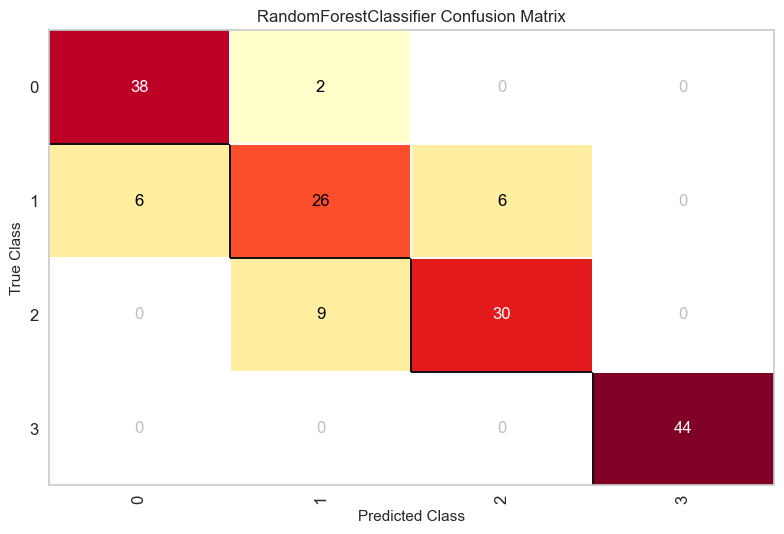

<AxesSubplot:title={'center':'RandomForestClassifier Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [113]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(
    RF3, classes=[0,1,2,3])


cm.fit(x_train, y_train)
cm.score(x_test, y_test)

cm.poof()

- RF3 model predict 44+30+26+38= 137 samples correctly.
- RF3 model predict 9+6+6+2= 23 samples uncorectly 
- RF model(before use grid search Cv)predicted more number of samples correctly.


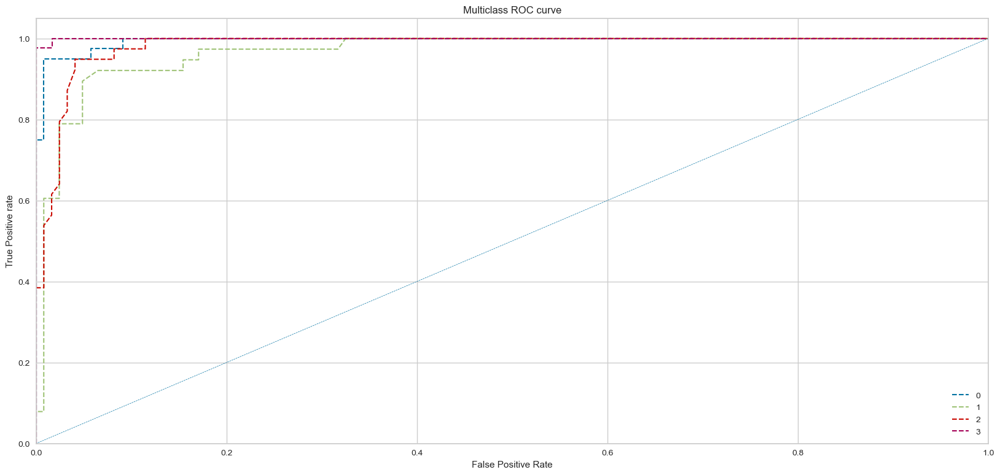

In [114]:
y_Pred_prob = RF.predict_proba(x_test)
def roc_curve_plot(y_actual , y_predicted_probs):
    
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = dict()

    n_class = np.unique(y_actual).shape[0]
    y_lb = label_binarize(y_test , classes = np.unique(y_actual))

    plt.figure(1 , figsize = (20 , 9))
    for i in range(n_class):
        
        fpr[i] , tpr[i] , thres[i] = roc_curve(y_lb[: , i] , y_predicted_probs[: , i])
        plt.plot(fpr[i] , tpr[i] , '--' , linewidth = 1.5,  label = '{}'.format(i))
    
    plt.plot([0 , 1] , [0 ,1] , 'b--' , linewidth = 0.5)
    plt.xlim([0 , 1])
    plt.ylim([0 , 1.05])
    plt.title('Multiclass ROC curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive rate')
    plt.legend(loc='lower right')
    plt.show()
    
roc_curve_plot(y_test , y_Pred_prob)

- Best Random forest model===RF
- test size=0.1
- n_estimators=170
- Criterion= gini
- Accuracy = 92.54%

### SUPPORT  VECTOR  MACHINE(SVM)

In [115]:
#split dataset in features and target variable
x = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1) #Target variable
print('shape of x : {} \nshape of y : {}'.format(x.shape , y.shape))

shape of x : (1609, 20) 
shape of y : (1609, 1)


In [116]:
def SVM_Model(x, y, testSize):

    global x_train , x_test , y_train , y_test , y_pred
    
    rows = []
    
    for n in testSize:
        x_train , x_test , y_train , y_test = train_test_split(x , y , test_size = n , random_state = 0)
        
        # Create SVM model
        svc=SVC(kernel='linear') 

        # fit SVM to training set
        svc.fit(x_train,y_train)

        # make predictions on test set
        y_pred=svc.predict(x_test)
            
        dataset = {'Test_size': n, 'acc': metrics.accuracy_score(y_test, y_pred), 'score': svc.score(x, y)}
        rows.append(dataset)
        evaluation3 = pd.DataFrame(rows)            
            
    return (evaluation3)   
# We want to hightlight the maximume values
def highlight_max(s):
    is_max = s == s.max()
    return ['background-color: green' if v else '' for v in is_max]

In [117]:
evaluation3 = SVM_Model(x, y, [0.1, 0.15, 0.2, 0.25, 0.3])
evaluation3.style.apply(highlight_max)

,Test_size,acc,score
0,0.100000,0.968944,0.989434
1,0.150000,0.975207,0.989434
2,0.200000,0.965839,0.990056
3,0.250000,0.965261,0.989434
4,0.300000,0.968944,0.988813


- test size=0.2

In [118]:
#split X and y in training and test set in 80:20 ratio
x_train , x_test , y_train , y_test = train_test_split(x , y , test_size = 0.2 , random_state = 0)
print('shape of x_train :',x_train.shape)
print('shape of y_train :',y_train.shape)
print('shape of x_test :',x_test.shape)
print('shape of y_test :',y_test.shape)

shape of x_train : (1287, 20)
shape of y_train : (1287, 1)
shape of x_test : (322, 20)
shape of y_test : (322, 1)


In [119]:
# Create SVM model
svm=SVC(kernel='linear',random_state = 1) 

svm.fit(x_train,y_train)

y_pred=svm.predict(x_test)

### Evaluation

In [120]:
Report(y_test , y_pred)

Accuracy : 96.58385093167702% 

Confusion Matrix : 

[[82  2  0  0]
 [ 0 69  0  0]
 [ 0  4 84  1]
 [ 0  0  4 76]]

Classification Report : 

              precision    recall  f1-score   support

           0       1.00      0.98      0.99        84
           1       0.92      1.00      0.96        69
           2       0.95      0.94      0.95        89
           3       0.99      0.95      0.97        80

    accuracy                           0.97       322
   macro avg       0.97      0.97      0.97       322
weighted avg       0.97      0.97      0.97       322



In [121]:
print('f1 score is:', metrics.f1_score(y_test, y_pred,average="macro"))

f1 score is: 0.9658976372942921


In [122]:
print('Train')
multi_class_metrics(y_train, svm.predict(x_train))
print('\nTest')
multi_class_metrics(y_test, svm.predict(x_test))

Train
Accuracy  :  0.996
Precision :  0.996
Recall    :  0.996
f1        :  0.996

Test
Accuracy  :  0.966
Precision :  0.966
Recall    :  0.966
f1        :  0.966


- After applying sklearn library,first model has 0.96 train accuracy 

- But how can we increase these scores? let'snapply gridsearch method

### MODEL WITH GRIDSEARCHCV

- To apply svm algorithm firstly I used GridSearchCV method to tune parameters. Some parameters are given below. 

In [123]:
kernel=["linear","rbf"]
gamma=["auto",0.01,0.001,0.0001,1]
decision_function_shape=["ovo","ovr"]

In [124]:
svm=SVC(random_state=1)
grid_svm=GridSearchCV(estimator=svm,cv=5,  param_grid=dict(kernel=kernel,
                                                         gamma=gamma,
                                                         decision_function_shape=decision_function_shape))
grid_svm.fit(x_train,y_train)
print("best score: ", grid_svm.best_score_)
print("best param: ", grid_svm.best_params_)

best score:  0.9689289053780955
best param:  {'decision_function_shape': 'ovo', 'gamma': 'auto', 'kernel': 'linear'}


45
45


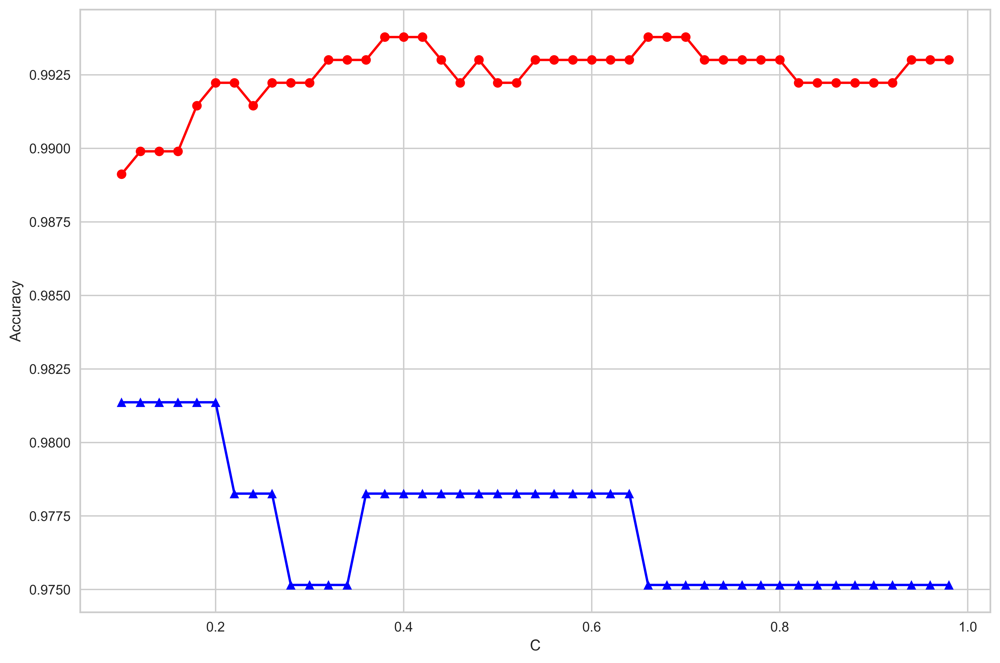

In [125]:
train_score, test_score = [], []
x = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1) #Target variable
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, shuffle = True, random_state = 1)

for i in np.arange(0.1,1,0.02):
    svm = SVC(random_state = 1, kernel = 'linear', decision_function_shape = 'ovo', C = i)
    svm.fit(x_train, y_train)
    train_score.append(svm.score(x_train, y_train))
    test_score.append(svm.score(x_test, y_test))

print(len(train_score))
print(len(test_score))

plt.figure(figsize = (12, 8), dpi = 600)
plt.plot(np.arange(0.1, 1, 0.02), train_score, marker = 'o', color = 'red', label = 'Train')
plt.plot(np.arange(0.1, 1, 0.02), test_score, marker = '^', color = 'blue', label = 'Test')
plt.xlabel('C')
plt.ylabel('Accuracy')
plt.show()

*Regarding the plot above, model with "linear" kernel performs best when "C" is equal to 0.2*

No lets build the model with the best parameters we have found with the Gridsearch method.

In [126]:
svm1=SVC(C=0.2,decision_function_shape="ovo",gamma="auto",kernel="linear",random_state=1)
svm1.fit(x_train,y_train)
y_pred = svm1.predict(x_test)

### Evaluation

In [127]:
Report(y_test , y_pred)

Accuracy : 98.13664596273291% 

Confusion Matrix : 

[[74  0  0  0]
 [ 1 90  3  0]
 [ 0  1 76  1]
 [ 0  0  0 76]]

Classification Report : 

              precision    recall  f1-score   support

           0       0.99      1.00      0.99        74
           1       0.99      0.96      0.97        94
           2       0.96      0.97      0.97        78
           3       0.99      1.00      0.99        76

    accuracy                           0.98       322
   macro avg       0.98      0.98      0.98       322
weighted avg       0.98      0.98      0.98       322



In [128]:
print('f1 score is:', metrics.f1_score(y_test, y_pred,average="macro"))

f1 score is: 0.981969620526655


In [129]:
print('Train')
multi_class_metrics(y_train, svm.predict(x_train))
print('\nTest')
multi_class_metrics(y_test, svm.predict(x_test))

Train
Accuracy  :  0.993
Precision :  0.993
Recall    :  0.993
f1        :  0.993

Test
Accuracy  :  0.975
Precision :  0.975
Recall    :  0.975
f1        :  0.975


- After applying grid search increase score.

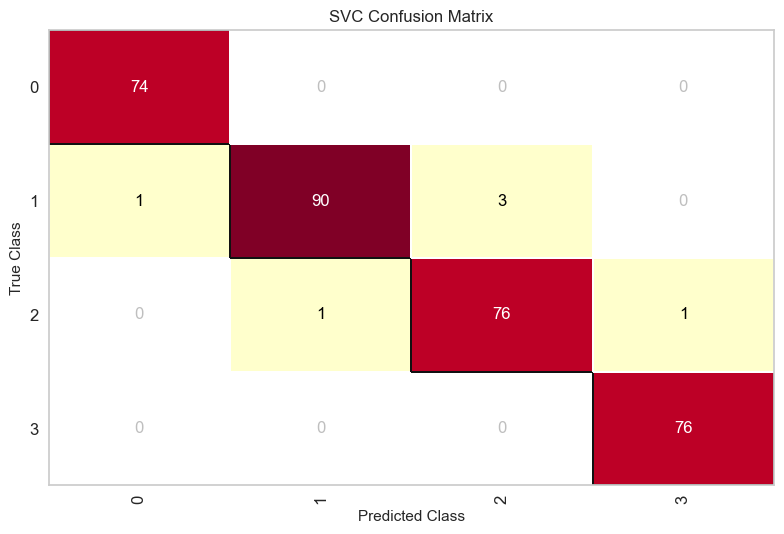

<AxesSubplot:title={'center':'SVC Confusion Matrix'}, xlabel='Predicted Class', ylabel='True Class'>

In [130]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(
    svm1, classes=[0,1,2,3])


cm.fit(x_train, y_train)
cm.score(x_test, y_test)

cm.poof()

- svm model predict 76+76+90+74= 316 samples correctly.
- svm model predict 1+1+3+1= 6 samples uncorectly 


## - Best SVM model== svm1
## - 'C': 0.2, 'decision_function_shape': 'ovo', 'gamma': 'auto', 'kernel': 'linear'
## - Accuracy = 98.14%

### Performance

In [131]:
All_models= {'Model':['DTs' , 'RF', 'SVM'],
             'Accuracy': [88.20,92.54,98.14 ],
            'f1_score': [ 87.92,92.32,98.20 ]}
             
comparison = pd.DataFrame(All_models)
comparison   

,Model,Accuracy,f1_score
0,DTs,88.20,87.92
1,RF,92.54,92.32
2,SVM,98.14,98.20


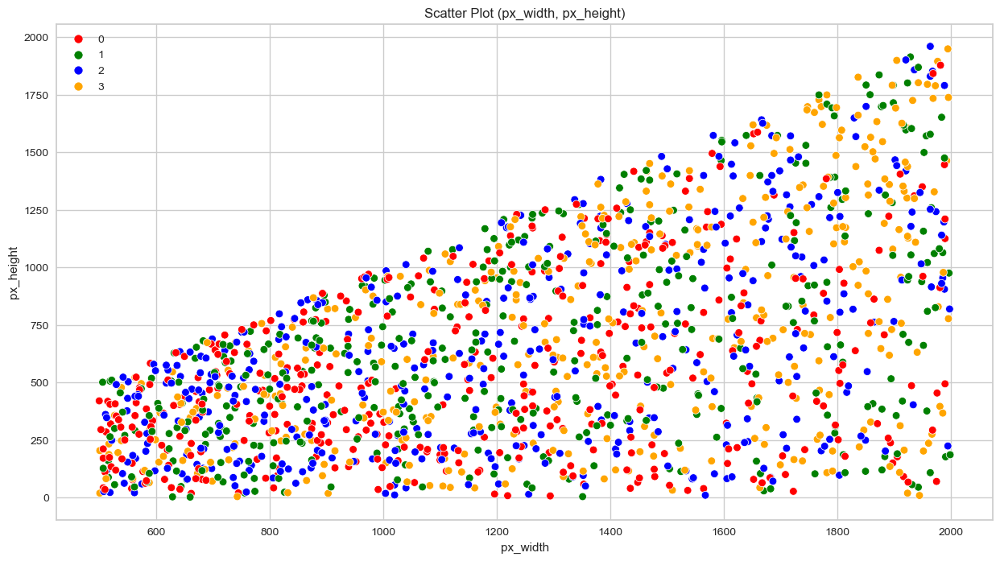

In [149]:
# Custom palette with four colors
custom_colors = ['red', 'green', 'blue', 'orange']
def scatter_plot(x, y, hue, data):
    plt.figure(1, figsize=(15, 8))
    sns.scatterplot(x=x, y=y, hue=hue, data=data, palette=custom_colors)
    plt.legend()
    plt.title(f'Scatter Plot ({x}, {y})')
    plt.show()
scatter_plot(x='px_width', y='px_height', hue='price_range', data=df)

### - Accuracy score is more in Svm model. the SVM algorithm is the best for this case study

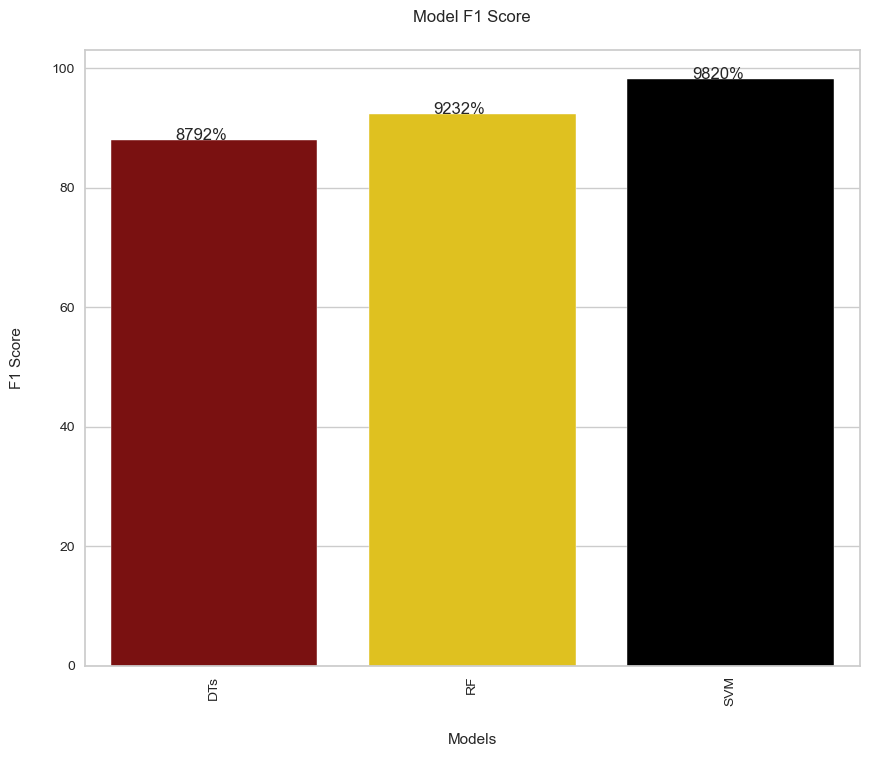

In [152]:
# Compare F1_score in all models with custom colors
fig, ax = plt.subplots(figsize=(10, 8))
custom_colors = ['darkred', 'gold', 'black'] 
sns.barplot(x='Model', y='f1_score', data=comparison, palette=custom_colors)
ax.set_title("Model F1 Score", pad=20)
ax.set_xlabel("Models", labelpad=20)
ax.set_ylabel("F1 Score", labelpad=20)
plt.xticks(rotation=90)
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate('{:.0%}'.format(height), (x + 0.25, y + height + 0.01))

### - F1_score  is more in Svm model. the SVM algorithm is the best for this case study. so we predict  data with svm model

- first we predict several data from train dataset to determine the model predicts correctly.

In [134]:
df.columns.tolist()

['battery_power',
 'blue',
 'clock_speed',
 'dual_sim',
 'fc',
 'four_g',
 'int_memory',
 'm_dep',
 'mobile_wt',
 'n_cores',
 'pc',
 'px_height',
 'px_width',
 'ram',
 'sc_h',
 'sc_w',
 'talk_time',
 'three_g',
 'touch_screen',
 'wifi',
 'price_range']

In [135]:
#creat a datafram from 4 smples of train data with price range 0,1,2,3
sample_pred= pd.DataFrame ({'battery_power':[563,1821,794,510],'blue':[1,1,1,1],'clock_speed':[0.5,1.2,0.5,2.0],
                          'dual_sim':[1,0,1,1],'fc':[2,13,0,5] ,'four_g':[1,1,1,1],'int_memory':[41,44,2,45],
                            'm_dep':[0.9,0.6,0.8,0.9],'mobile_wt':[145,141,106,168], 'n_cores':[5,2,6,6], 
                            'pc':[6,14,14,16],'px_height':[1263,1208,122,483],'px_width':[1716,1212,1890,754],
                            'ram':[2603,1411,668,3919],'sc_h':[11,8,13,19],'sc_w':[2,2,4,4],'talk_time':[9,15,19,2],
                            'three_g':[1,1,1,1],'touch_screen':[1,1,1,1], 'wifi':[0,0,0,1],'price_range':[2,1,0,3]})
                            
sample_pred      

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
1,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1
2,794,1,0.5,1,0,1,2,0.8,106,6,14,122,1890,668,13,4,19,1,1,0,0
3,510,1,2.0,1,5,1,45,0.9,168,6,16,483,754,3919,19,4,2,1,1,1,3


In [136]:
df_pred= df.append(sample_pred)
df_pred

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1
5,1821,0,1.7,0,4,1,10,0.8,139,8,10,381,1018,3220,13,8,18,1,0,1,3
6,1954,0,0.5,1,0,0,24,0.8,187,4,0,512,1149,700,16,3,5,1,1,1,0
7,509,1,0.6,1,2,1,9,0.1,93,5,15,1137,1224,513,19,10,12,1,0,0,0
8,769,1,2.9,1,0,0,9,0.1,182,5,1,248,874,3946,5,2,7,0,0,0,3
9,1520,1,2.2,0,5,1,33,0.5,177,8,18,151,1005,3826,14,9,13,1,1,1,3


In [137]:
#define train and test
train=df_pred.iloc[:1609]
test= df_pred.iloc[1609:]

In [138]:
x_train= df_pred.drop (['price_range'], axis=1)[:1609]
y_train=df_pred['price_range'][:1609]
x_test=  df_pred.drop (['price_range'], axis=1)[1609:]
svm1.fit(x_train,y_train)

SVC(C=0.2, decision_function_shape='ovo', gamma='auto', kernel='linear',
    random_state=1)

In [139]:
#predict samples
y_pred1=svm1.predict(x_test)
y_pred1

array([2, 1, 0, 3], dtype=int64)

### - svm model predict all samles correctly.

### - so we predict test data (unseen) with svm model¶

In [140]:
#min of test dataset
df1.min()

id               1.0  
battery_power    500.0
blue             0.0  
clock_speed      0.5  
dual_sim         0.0  
fc               0.0  
four_g           0.0  
int_memory       2.0  
m_dep            0.1  
mobile_wt        80.0 
n_cores          1.0  
pc               0.0  
px_height        0.0  
px_width         501.0
ram              263.0
sc_h             5.0  
sc_w             0.0  
talk_time        2.0  
three_g          0.0  
touch_screen     0.0  
wifi             0.0  
dtype: float64

- there are values equal to zero in both "px_height" and "sc_w". The problem with these points is that they cannot represent a feature of a mobile phone, as there is no 1D pixel or a 1D screen !

In [141]:
px_mask = df1['px_height'] == 0
sc_mask = df1['sc_w'] == 0
print(f'pixel height = 0  :  {sum(px_mask)}')
print(f'screen width = 0  :  {sum(sc_mask)}')

pixel height = 0  :  2
screen width = 0  :  112


In [142]:

df1=df1[df1['sc_w']>=2]
df1=df1[df1['px_height']>0]
df1.reset_index(inplace=True)
df1.drop('index', axis=1, inplace=True)
df1

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,3,16,226,1412,3476,12,7,2,0,1,0
1,3,1807,1,2.8,0,1,0,27,0.9,186,3,4,1270,1366,2396,17,10,10,0,1,1
2,5,1434,0,1.4,0,11,1,49,0.5,108,6,18,749,810,1773,15,8,7,1,0,1
3,6,1464,1,2.9,1,5,1,50,0.8,198,8,9,569,939,3506,10,7,3,1,1,1
4,7,1718,0,2.4,0,1,0,47,1.0,156,2,3,1283,1374,3873,14,2,10,0,0,0
5,8,833,0,2.4,1,0,0,62,0.8,111,1,2,1312,1880,1495,7,2,18,0,1,1
6,9,1111,1,2.9,1,9,1,25,0.6,101,5,19,556,876,3485,11,9,10,1,1,0
7,11,1500,0,2.2,0,2,0,55,0.6,80,7,6,503,1336,3866,13,7,20,0,1,0
8,12,1343,0,2.9,0,2,1,34,0.8,171,3,6,235,1671,3911,15,8,8,1,1,1
9,13,900,1,1.4,1,0,0,30,1.0,87,2,3,829,1893,439,6,2,20,1,0,0


In [143]:
df1.drop('id',axis=1,inplace=True)

### - predict test dataset with svm model (unseen samples)

In [144]:
#split dataset in features and target variable

y_pred = svm1.predict(df1)

In [145]:
y_pred

array([3, 2, 1, 3, 3, 1, 3, 3, 3, 0, 2, 0, 2, 1, 3, 3, 1, 3, 0, 2, 0, 3,
       0, 2, 0, 3, 0, 0, 1, 3, 1, 1, 1, 2, 0, 0, 1, 3, 1, 1, 0, 0, 3, 1,
       3, 1, 3, 3, 1, 2, 1, 2, 1, 2, 2, 3, 0, 0, 2, 0, 3, 3, 0, 3, 0, 3,
       1, 3, 1, 2, 2, 1, 2, 2, 0, 0, 3, 0, 2, 0, 1, 2, 3, 3, 2, 3, 3, 3,
       2, 3, 0, 0, 3, 2, 1, 2, 0, 2, 3, 2, 2, 1, 1, 3, 1, 1, 1, 1, 2, 3,
       3, 2, 3, 2, 3, 2, 3, 3, 3, 3, 2, 2, 3, 3, 3, 1, 3, 0, 2, 0, 1, 0,
       0, 1, 2, 1, 0, 0, 1, 2, 2, 1, 0, 0, 1, 0, 1, 0, 2, 3, 3, 2, 2, 2,
       3, 2, 1, 1, 0, 1, 2, 0, 2, 3, 0, 2, 0, 3, 2, 3, 0, 1, 0, 3, 0, 0,
       2, 2, 1, 3, 3, 0, 3, 1, 2, 0, 0, 1, 3, 3, 3, 0, 0, 2, 3, 1, 3, 1,
       3, 1, 2, 3, 3, 1, 0, 1, 3, 1, 1, 3, 2, 1, 0, 1, 2, 1, 0, 3, 2, 3,
       3, 2, 3, 3, 2, 1, 1, 0, 2, 0, 0, 3, 0, 3, 0, 1, 2, 0, 2, 3, 1, 2,
       2, 1, 0, 0, 1, 3, 2, 0, 0, 0, 3, 0, 2, 3, 1, 2, 2, 2, 1, 3, 3, 2,
       2, 3, 3, 3, 3, 3, 1, 3, 3, 0, 1, 0, 3, 1, 2, 3, 0, 0, 0, 0, 2, 0,
       2, 2, 2, 2, 0, 0, 0, 3, 0, 3, 2, 2, 1, 2, 3,

In [146]:
df1['price_range_t'] = y_pred

In [147]:
df1

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range_t
0,1043,1,1.8,1,14,0,5,0.1,193,3,16,226,1412,3476,12,7,2,0,1,0,3
1,1807,1,2.8,0,1,0,27,0.9,186,3,4,1270,1366,2396,17,10,10,0,1,1,2
2,1434,0,1.4,0,11,1,49,0.5,108,6,18,749,810,1773,15,8,7,1,0,1,1
3,1464,1,2.9,1,5,1,50,0.8,198,8,9,569,939,3506,10,7,3,1,1,1,3
4,1718,0,2.4,0,1,0,47,1.0,156,2,3,1283,1374,3873,14,2,10,0,0,0,3
5,833,0,2.4,1,0,0,62,0.8,111,1,2,1312,1880,1495,7,2,18,0,1,1,1
6,1111,1,2.9,1,9,1,25,0.6,101,5,19,556,876,3485,11,9,10,1,1,0,3
7,1500,0,2.2,0,2,0,55,0.6,80,7,6,503,1336,3866,13,7,20,0,1,0,3
8,1343,0,2.9,0,2,1,34,0.8,171,3,6,235,1671,3911,15,8,8,1,1,1,3
9,900,1,1.4,1,0,0,30,1.0,87,2,3,829,1893,439,6,2,20,1,0,0,0


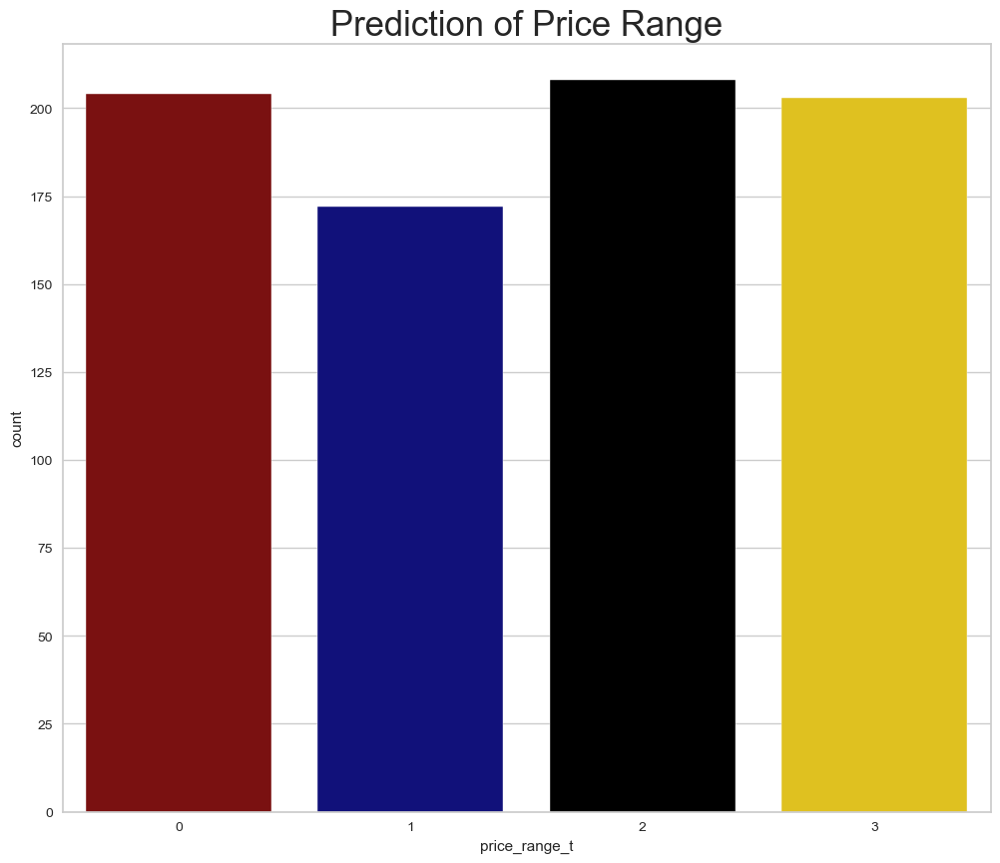

In [154]:
# Custom colors
custom_colors = ['darkred', 'darkblue', 'black', 'gold']  # Add your custom colors here
plt.figure(figsize=(12, 10))
sns.countplot(x="price_range_t", data=df1, palette=custom_colors)
plt.title("Prediction of Price Range", fontsize=25)
plt.show()